In [10]:
# ============================================================================
# IMPORTS AND SETUP
# ============================================================================

import torch
import torch.nn as nn
import torch.optim as optim
import torchvision
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
import random

# Set random seed for reproducibility
manualSeed = 999
random.seed(manualSeed)
torch.manual_seed(manualSeed)
print("Random Seed: ", manualSeed)


Random Seed:  999


In [11]:
# ============================================================================
# HYPERPARAMETERS
# ============================================================================

# Root directory for dataset (For Kaggle environment, usually not directly used for MNIST download)
dataroot = "/kaggle/input"  

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 128

# Spatial size of training images (MNIST is 28x28, we'll resize to 64x64)
image_size = 64

# Number of channels in the training images (MNIST is grayscale = 1)
nc = 1

# Size of z latent vector (generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 30 # Increased epochs for better convergence

# Learning rate for optimizers
lr_D = 0.0001 # Reduced learning rate for Discriminator
lr_G = 0.0002 # Kept Generator LR as original

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Label smoothing parameters (helps stabilize training)
# Adjusted for better D-G balance
real_label_smooth = 0.85  # Slightly reduced from 0.9
fake_label_smooth = 0.2   # Increased from 0.1

# Number of GPUs available (0 for CPU mode)
ngpu = 1

# Decide which device to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")
print(f"Using device: {device}")

Using device: cuda:0


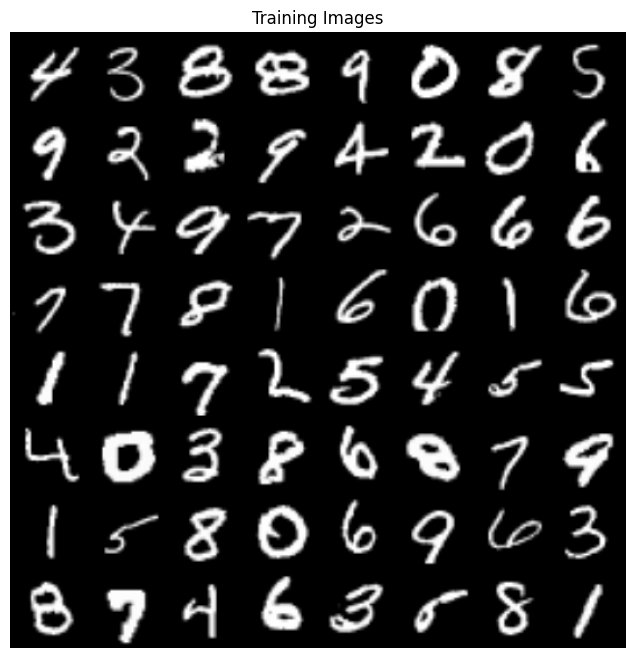

In [12]:
# ============================================================================
# DATA LOADING AND PREPROCESSING
# ============================================================================

# Create the dataset
transform = transforms.Compose([
    transforms.Resize(image_size),
    transforms.CenterCrop(image_size),
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))  # Normalize to [-1, 1]
])

# For Kaggle, we'll download MNIST directly
# Ensure 'data' directory exists or is writable if running locally
dataset = torchvision.datasets.MNIST(root='./data', train=True, download=True, transform=transform)

# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0][:64], padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()

# ============================================================================
# WEIGHT INITIALIZATION
# ============================================================================

def weights_init(m):
    """
    Custom weights initialization called on netG and netD
    From DCGAN paper: all weights randomly initialized from Normal(0, 0.02)
    """
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [13]:
# ============================================================================
# GENERATOR NETWORK
# ============================================================================

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # Input is Z, going into a convolution
            nn.ConvTranspose2d(nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size: (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size: (ngf*4) x 8 x 8
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size: (ngf*2) x 16 x 16
            nn.ConvTranspose2d(ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size: (ngf) x 32 x 32
            nn.ConvTranspose2d(ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size: (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
netG.apply(weights_init)

# Print the model
print("Generator Architecture:")
print(netG)


Generator Architecture:
Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 1, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)

In [14]:
# ============================================================================
# DISCRIMINATOR NETWORK
# ============================================================================

class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # Input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size: (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size: (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size: (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size: (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input).view(-1, 1).squeeze(1)

# Create the discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
netD.apply(weights_init)

# Print the model
print("\nDiscriminator Architecture:")
print(netD)


Discriminator Architecture:
Discriminator(
  (main): Sequential(
    (0): Conv2d(1, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [15]:
# ============================================================================
# LOSS FUNCTION AND OPTIMIZERS
# ============================================================================

# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors for visualization
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training (with smoothing)
real_label_val = real_label_smooth
fake_label_val = fake_label_smooth

# Setup Adam optimizers for both G and D with adjusted learning rates
optimizerD = optim.Adam(netD.parameters(), lr=lr_D, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr_G, betas=(beta1, 0.999))


Starting Training...
[0/30][0/469]	Loss_D: 1.8088	Loss_G: 2.3648	D(x): 0.7141	D(G(z)): 0.7088 / 0.0910
[0/30][50/469]	Loss_D: 1.6883	Loss_G: 2.4105	D(x): 0.8172	D(G(z)): 0.0034 / 0.0706
[0/30][100/469]	Loss_D: 1.0343	Loss_G: 0.8522	D(x): 0.8331	D(G(z)): 0.1017 / 0.4248
[0/30][150/469]	Loss_D: 2.4628	Loss_G: 3.3989	D(x): 0.3580	D(G(z)): 0.0035 / 0.0319
[0/30][200/469]	Loss_D: 1.0351	Loss_G: 1.2837	D(x): 0.7453	D(G(z)): 0.1791 / 0.2394
[0/30][250/469]	Loss_D: 1.0093	Loss_G: 1.9242	D(x): 0.8608	D(G(z)): 0.3362 / 0.1114
[0/30][300/469]	Loss_D: 0.9705	Loss_G: 2.6748	D(x): 0.8810	D(G(z)): 0.2759 / 0.0450
[0/30][350/469]	Loss_D: 1.0189	Loss_G: 2.6441	D(x): 0.8622	D(G(z)): 0.3561 / 0.0470
[0/30][400/469]	Loss_D: 1.0293	Loss_G: 1.2751	D(x): 0.7501	D(G(z)): 0.1431 / 0.2435
[0/30][450/469]	Loss_D: 0.9949	Loss_G: 1.6641	D(x): 0.8161	D(G(z)): 0.3032 / 0.1516

--- End of Epoch 1/30 ---


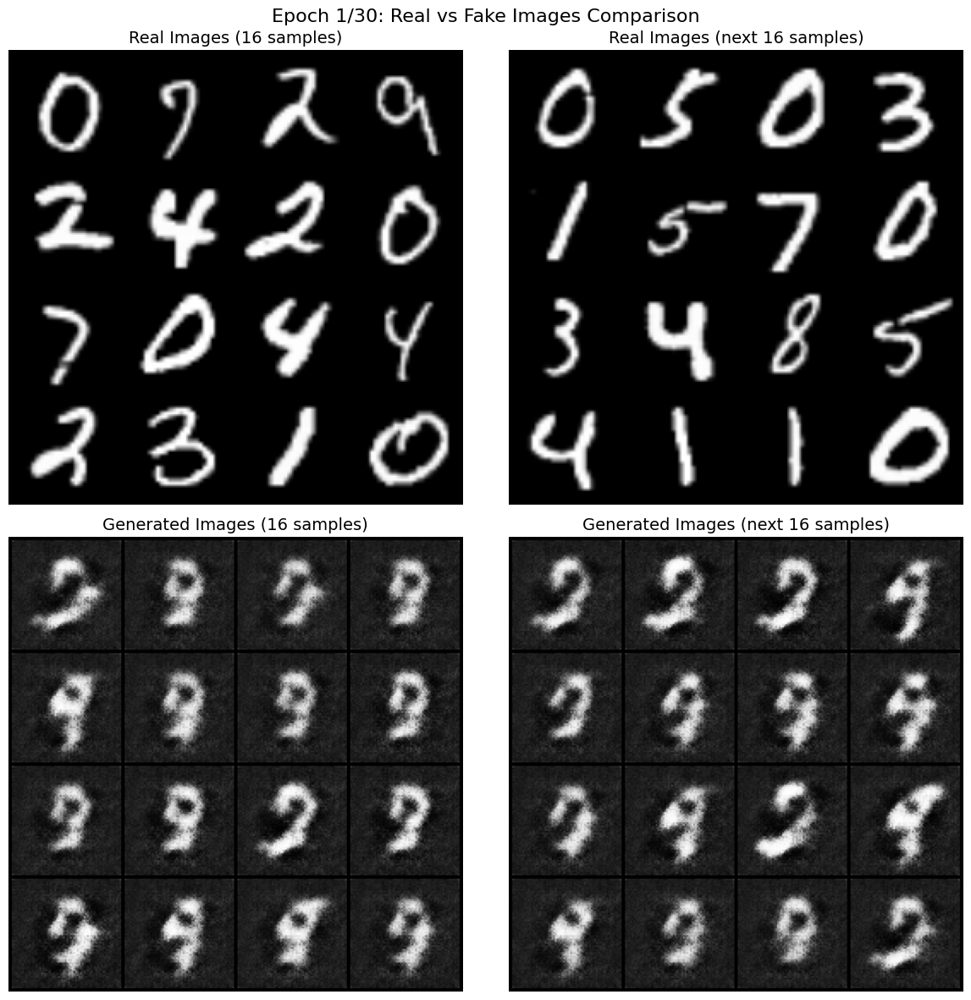

Epoch 1 Summary:
  Average Generator Loss: 2.5191
  Average Discriminator Loss: 1.1825
  D(real_images): 0.7963 (should be close to 1, or real_label_smooth)
  D(fake_images): 0.2698 (should be close to 0, or fake_label_smooth)
  🟢 Discriminator is strong but not overpowering, and G is learning.
  Total iterations completed: 469
--------------------------------------------------
[1/30][0/469]	Loss_D: 0.9806	Loss_G: 1.4742	D(x): 0.8293	D(G(z)): 0.2783 / 0.1874
[1/30][50/469]	Loss_D: 1.2513	Loss_G: 3.9539	D(x): 0.9045	D(G(z)): 0.5543 / 0.0108
[1/30][100/469]	Loss_D: 0.9761	Loss_G: 1.6441	D(x): 0.8268	D(G(z)): 0.2730 / 0.1568
[1/30][150/469]	Loss_D: 1.0303	Loss_G: 1.8462	D(x): 0.8557	D(G(z)): 0.3790 / 0.1207
[1/30][200/469]	Loss_D: 1.2943	Loss_G: 2.4578	D(x): 0.9356	D(G(z)): 0.5630 / 0.0652
[1/30][250/469]	Loss_D: 0.9905	Loss_G: 1.5477	D(x): 0.8389	D(G(z)): 0.3179 / 0.1759
[1/30][300/469]	Loss_D: 1.0524	Loss_G: 1.0371	D(x): 0.6756	D(G(z)): 0.1721 / 0.3323
[1/30][350/469]	Loss_D: 0.9976	Los

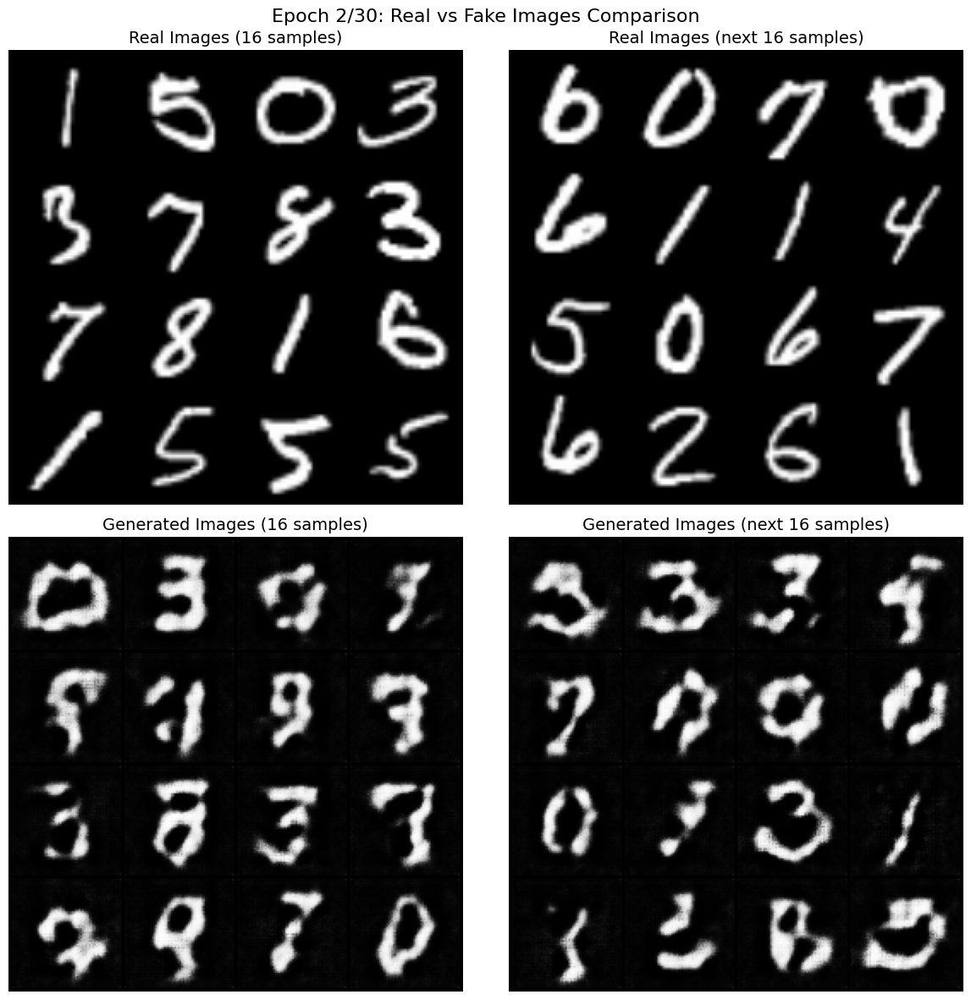

Epoch 2 Summary:
  Average Generator Loss: 1.9604
  Average Discriminator Loss: 1.1235
  D(real_images): 0.7820 (should be close to 1, or real_label_smooth)
  D(fake_images): 0.2761 (should be close to 0, or fake_label_smooth)
  🟢 Discriminator is strong but not overpowering, and G is learning.
  Total iterations completed: 938
--------------------------------------------------
[2/30][0/469]	Loss_D: 1.0493	Loss_G: 1.1852	D(x): 0.8164	D(G(z)): 0.4001 / 0.2702
[2/30][50/469]	Loss_D: 1.0896	Loss_G: 0.7525	D(x): 0.6357	D(G(z)): 0.2776 / 0.4738
[2/30][100/469]	Loss_D: 1.2952	Loss_G: 1.7169	D(x): 0.8663	D(G(z)): 0.5990 / 0.1436
[2/30][150/469]	Loss_D: 1.1450	Loss_G: 1.1829	D(x): 0.7338	D(G(z)): 0.4604 / 0.2757
[2/30][200/469]	Loss_D: 1.2533	Loss_G: 0.6019	D(x): 0.4910	D(G(z)): 0.1700 / 0.5874
[2/30][250/469]	Loss_D: 1.0819	Loss_G: 0.9479	D(x): 0.6661	D(G(z)): 0.3299 / 0.3652
[2/30][300/469]	Loss_D: 1.0446	Loss_G: 1.3854	D(x): 0.7851	D(G(z)): 0.3879 / 0.2130
[2/30][350/469]	Loss_D: 1.3484	Los

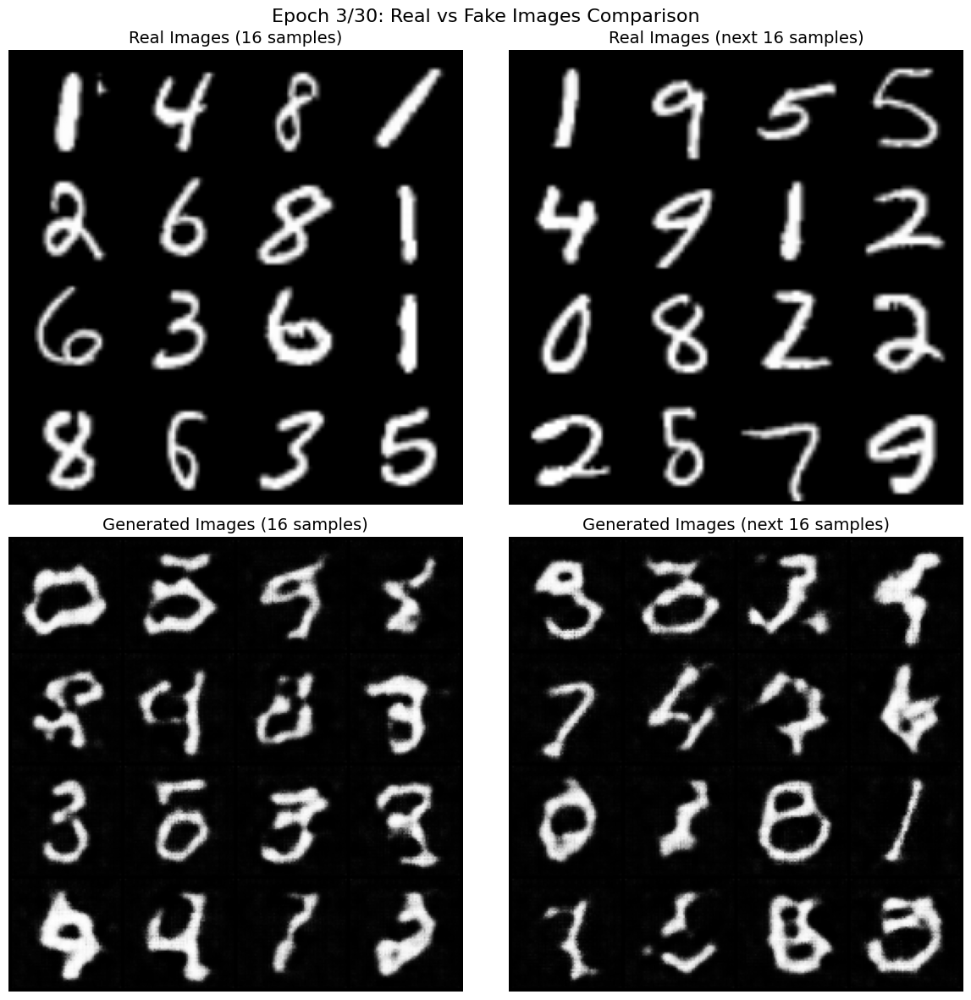

Epoch 3 Summary:
  Average Generator Loss: 1.6703
  Average Discriminator Loss: 1.1382
  D(real_images): 0.7490 (should be close to 1, or real_label_smooth)
  D(fake_images): 0.3061 (should be close to 0, or fake_label_smooth)
  🟡 Training dynamics look reasonable
  Total iterations completed: 1407
--------------------------------------------------
[3/30][0/469]	Loss_D: 1.3621	Loss_G: 1.7511	D(x): 0.8689	D(G(z)): 0.6286 / 0.1437
[3/30][50/469]	Loss_D: 1.0778	Loss_G: 0.8679	D(x): 0.6407	D(G(z)): 0.2448 / 0.4120
[3/30][100/469]	Loss_D: 1.1695	Loss_G: 1.4265	D(x): 0.7697	D(G(z)): 0.4965 / 0.2077
[3/30][150/469]	Loss_D: 1.1383	Loss_G: 0.7969	D(x): 0.5854	D(G(z)): 0.2151 / 0.4479
[3/30][200/469]	Loss_D: 1.1592	Loss_G: 0.8345	D(x): 0.5811	D(G(z)): 0.2961 / 0.4295
[3/30][250/469]	Loss_D: 1.4348	Loss_G: 1.8169	D(x): 0.8976	D(G(z)): 0.6553 / 0.1336
[3/30][300/469]	Loss_D: 1.0358	Loss_G: 0.9438	D(x): 0.6769	D(G(z)): 0.2224 / 0.3694
[3/30][350/469]	Loss_D: 1.1994	Loss_G: 0.7660	D(x): 0.5363	D(G(z

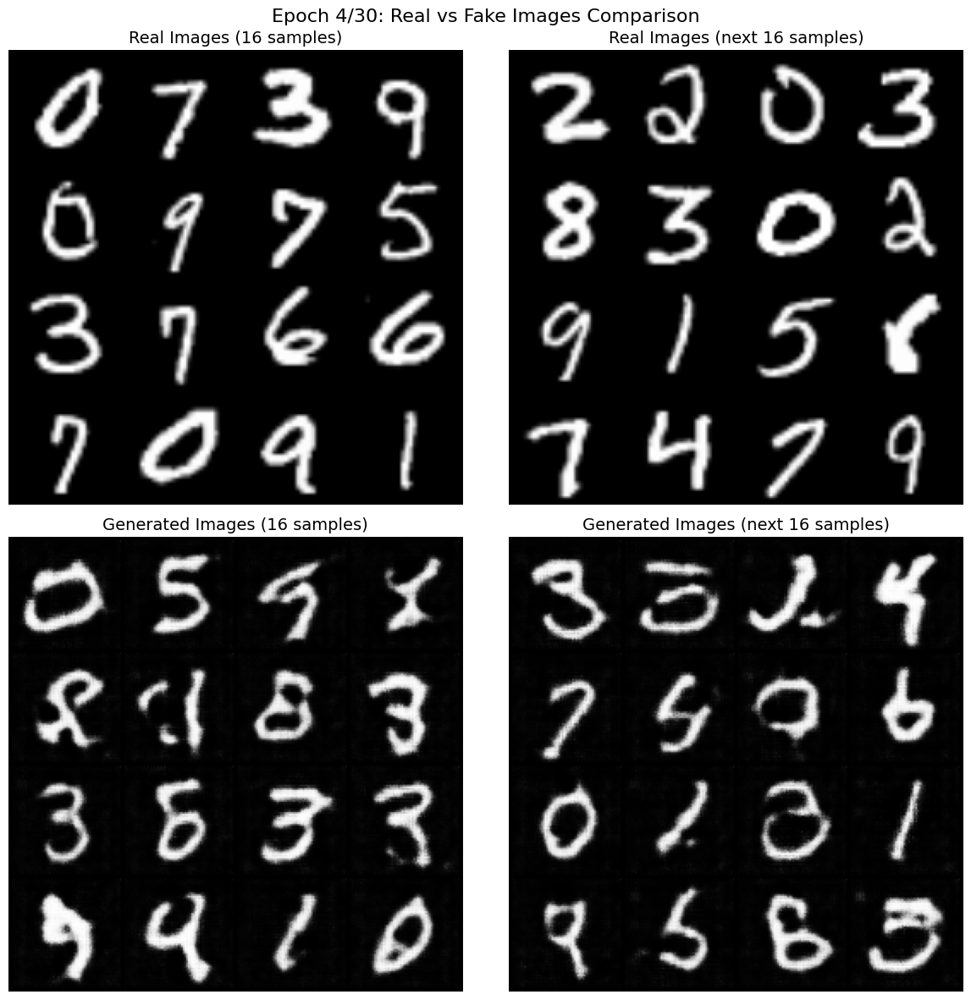

Epoch 4 Summary:
  Average Generator Loss: 1.5318
  Average Discriminator Loss: 1.1417
  D(real_images): 0.7343 (should be close to 1, or real_label_smooth)
  D(fake_images): 0.3197 (should be close to 0, or fake_label_smooth)
  🟡 Training dynamics look reasonable
  Total iterations completed: 1876
--------------------------------------------------
[4/30][0/469]	Loss_D: 1.1829	Loss_G: 0.6841	D(x): 0.5460	D(G(z)): 0.1524 / 0.5253
[4/30][50/469]	Loss_D: 1.1092	Loss_G: 0.7825	D(x): 0.5989	D(G(z)): 0.2204 / 0.4581
[4/30][100/469]	Loss_D: 1.0291	Loss_G: 1.0685	D(x): 0.7274	D(G(z)): 0.3103 / 0.3181
[4/30][150/469]	Loss_D: 1.2044	Loss_G: 2.0606	D(x): 0.8680	D(G(z)): 0.5369 / 0.0958
[4/30][200/469]	Loss_D: 1.2232	Loss_G: 1.1487	D(x): 0.6982	D(G(z)): 0.5030 / 0.2889
[4/30][250/469]	Loss_D: 1.1614	Loss_G: 1.0232	D(x): 0.6870	D(G(z)): 0.4453 / 0.3331
[4/30][300/469]	Loss_D: 1.1289	Loss_G: 1.2953	D(x): 0.7871	D(G(z)): 0.4656 / 0.2422
[4/30][350/469]	Loss_D: 1.1063	Loss_G: 1.0044	D(x): 0.6449	D(G(z

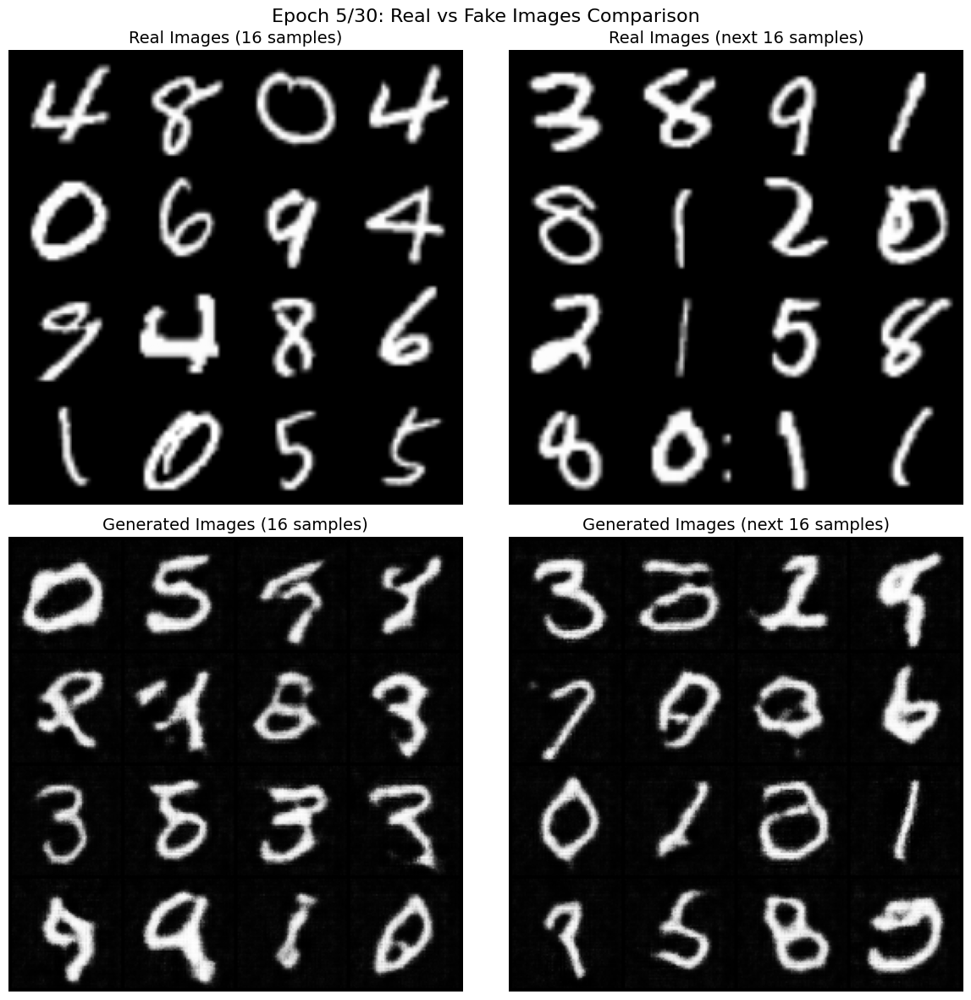

Epoch 5 Summary:
  Average Generator Loss: 1.4449
  Average Discriminator Loss: 1.1468
  D(real_images): 0.7236 (should be close to 1, or real_label_smooth)
  D(fake_images): 0.3295 (should be close to 0, or fake_label_smooth)
  🟡 Training dynamics look reasonable
  Total iterations completed: 2345
--------------------------------------------------
[5/30][0/469]	Loss_D: 1.2880	Loss_G: 0.6259	D(x): 0.4757	D(G(z)): 0.1669 / 0.5668
[5/30][50/469]	Loss_D: 1.2801	Loss_G: 2.2481	D(x): 0.9225	D(G(z)): 0.5640 / 0.0784
[5/30][100/469]	Loss_D: 1.0423	Loss_G: 1.4974	D(x): 0.7900	D(G(z)): 0.3809 / 0.1888
[5/30][150/469]	Loss_D: 1.1913	Loss_G: 0.7122	D(x): 0.5395	D(G(z)): 0.2049 / 0.5005
[5/30][200/469]	Loss_D: 1.0694	Loss_G: 0.7787	D(x): 0.6438	D(G(z)): 0.2144 / 0.4589
[5/30][250/469]	Loss_D: 1.0677	Loss_G: 1.1139	D(x): 0.7060	D(G(z)): 0.3487 / 0.2995
[5/30][300/469]	Loss_D: 1.4935	Loss_G: 2.2438	D(x): 0.9397	D(G(z)): 0.6745 / 0.0777
[5/30][350/469]	Loss_D: 1.0109	Loss_G: 1.1269	D(x): 0.7128	D(G(z

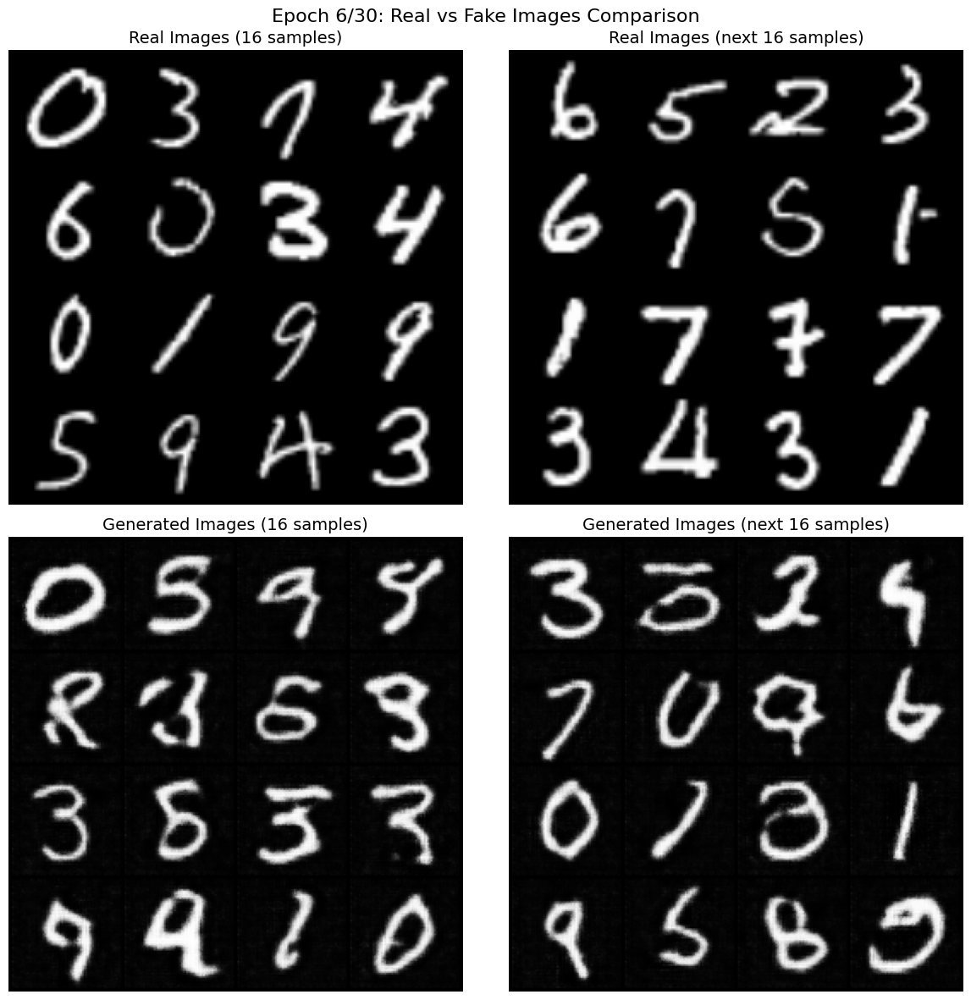

Epoch 6 Summary:
  Average Generator Loss: 1.4024
  Average Discriminator Loss: 1.1429
  D(real_images): 0.7213 (should be close to 1, or real_label_smooth)
  D(fake_images): 0.3312 (should be close to 0, or fake_label_smooth)
  🟡 Training dynamics look reasonable
  Total iterations completed: 2814
--------------------------------------------------
[6/30][0/469]	Loss_D: 1.1373	Loss_G: 1.5895	D(x): 0.8416	D(G(z)): 0.4822 / 0.1705
[6/30][50/469]	Loss_D: 1.0273	Loss_G: 1.3880	D(x): 0.7907	D(G(z)): 0.3530 / 0.2156
[6/30][100/469]	Loss_D: 1.1947	Loss_G: 0.9122	D(x): 0.5666	D(G(z)): 0.3455 / 0.3858
[6/30][150/469]	Loss_D: 1.0537	Loss_G: 1.0925	D(x): 0.7047	D(G(z)): 0.3220 / 0.3092
[6/30][200/469]	Loss_D: 1.2600	Loss_G: 1.8327	D(x): 0.8893	D(G(z)): 0.5686 / 0.1263
[6/30][250/469]	Loss_D: 1.0129	Loss_G: 1.2536	D(x): 0.7030	D(G(z)): 0.2208 / 0.2513
[6/30][300/469]	Loss_D: 1.1796	Loss_G: 0.9588	D(x): 0.5608	D(G(z)): 0.1260 / 0.3632
[6/30][350/469]	Loss_D: 1.0624	Loss_G: 1.0290	D(x): 0.6671	D(G(z

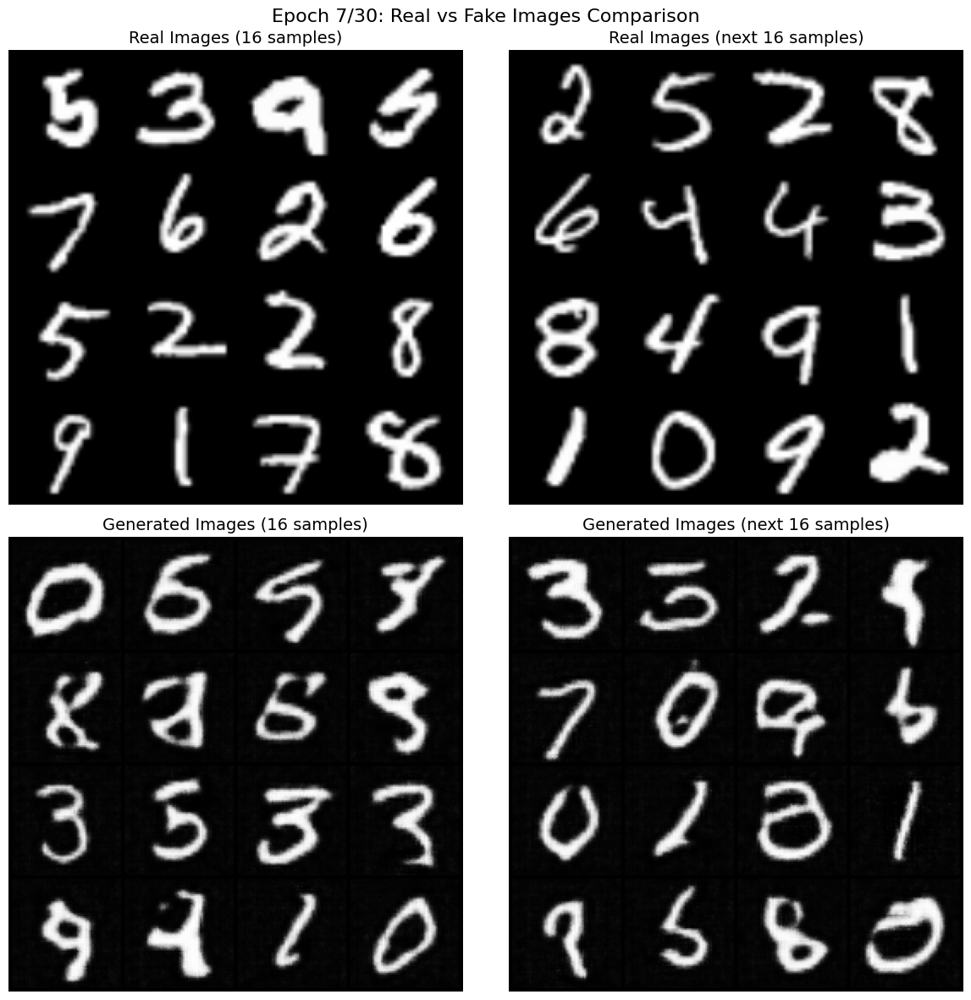

Epoch 7 Summary:
  Average Generator Loss: 1.3782
  Average Discriminator Loss: 1.1373
  D(real_images): 0.7215 (should be close to 1, or real_label_smooth)
  D(fake_images): 0.3306 (should be close to 0, or fake_label_smooth)
  🟡 Training dynamics look reasonable
  Total iterations completed: 3283
--------------------------------------------------
[7/30][0/469]	Loss_D: 1.0138	Loss_G: 1.2003	D(x): 0.7122	D(G(z)): 0.2451 / 0.2694
[7/30][50/469]	Loss_D: 1.0402	Loss_G: 1.5995	D(x): 0.8294	D(G(z)): 0.3944 / 0.1664
[7/30][100/469]	Loss_D: 1.0289	Loss_G: 1.5753	D(x): 0.7903	D(G(z)): 0.3657 / 0.1707
[7/30][150/469]	Loss_D: 1.1135	Loss_G: 0.7846	D(x): 0.5953	D(G(z)): 0.1981 / 0.4586
[7/30][200/469]	Loss_D: 1.1549	Loss_G: 1.5341	D(x): 0.8691	D(G(z)): 0.4930 / 0.1782
[7/30][250/469]	Loss_D: 1.1092	Loss_G: 0.8443	D(x): 0.5982	D(G(z)): 0.1704 / 0.4165
[7/30][300/469]	Loss_D: 1.1913	Loss_G: 2.0102	D(x): 0.8933	D(G(z)): 0.5134 / 0.1034
[7/30][350/469]	Loss_D: 1.0510	Loss_G: 1.3058	D(x): 0.7471	D(G(z

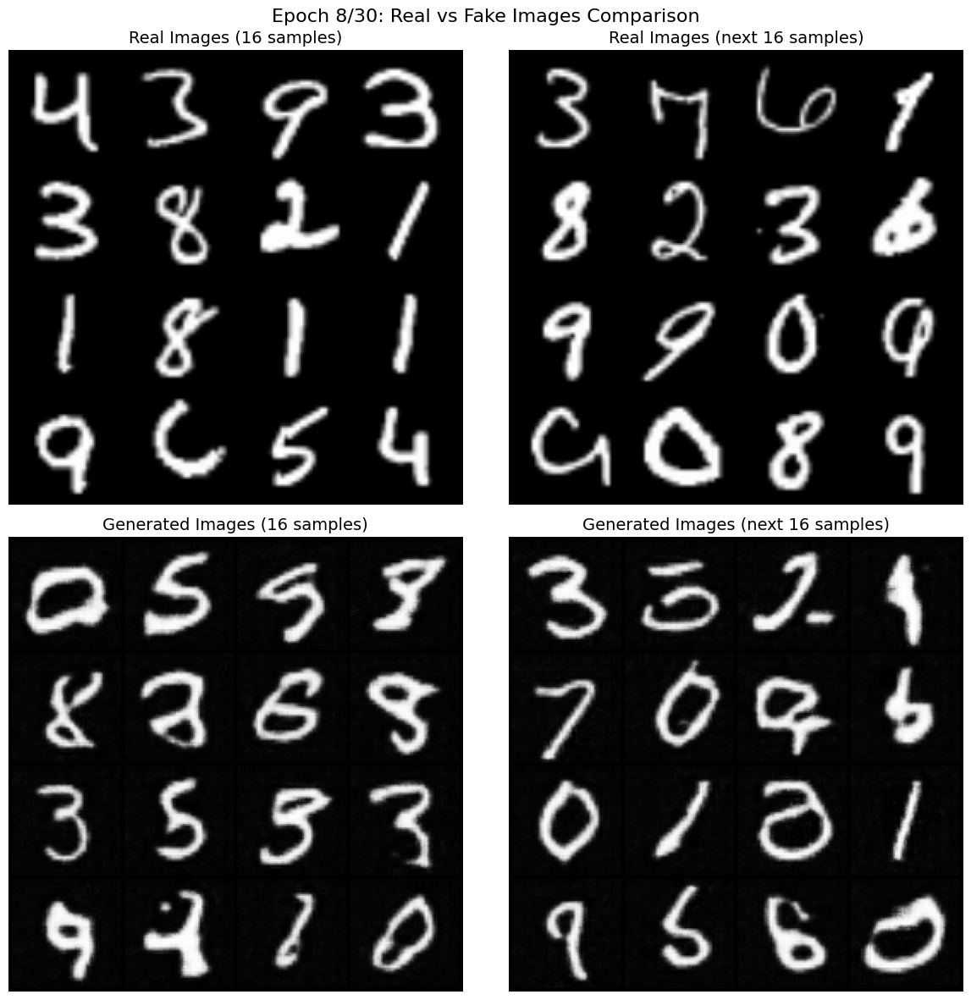

Epoch 8 Summary:
  Average Generator Loss: 1.3651
  Average Discriminator Loss: 1.1309
  D(real_images): 0.7230 (should be close to 1, or real_label_smooth)
  D(fake_images): 0.3289 (should be close to 0, or fake_label_smooth)
  🟡 Training dynamics look reasonable
  Total iterations completed: 3752
--------------------------------------------------
[8/30][0/469]	Loss_D: 1.0079	Loss_G: 1.1612	D(x): 0.7480	D(G(z)): 0.2857 / 0.2818
[8/30][50/469]	Loss_D: 1.0848	Loss_G: 0.9366	D(x): 0.6247	D(G(z)): 0.1750 / 0.3719
[8/30][100/469]	Loss_D: 1.0310	Loss_G: 1.4745	D(x): 0.8049	D(G(z)): 0.3731 / 0.1922
[8/30][150/469]	Loss_D: 0.9900	Loss_G: 1.2366	D(x): 0.7670	D(G(z)): 0.2627 / 0.2584
[8/30][200/469]	Loss_D: 1.0245	Loss_G: 0.9764	D(x): 0.6891	D(G(z)): 0.2167 / 0.3523
[8/30][250/469]	Loss_D: 1.2300	Loss_G: 2.2723	D(x): 0.8986	D(G(z)): 0.5466 / 0.0751
[8/30][300/469]	Loss_D: 1.0157	Loss_G: 1.2305	D(x): 0.7357	D(G(z)): 0.3008 / 0.2549
[8/30][350/469]	Loss_D: 1.2643	Loss_G: 2.1732	D(x): 0.8992	D(G(z

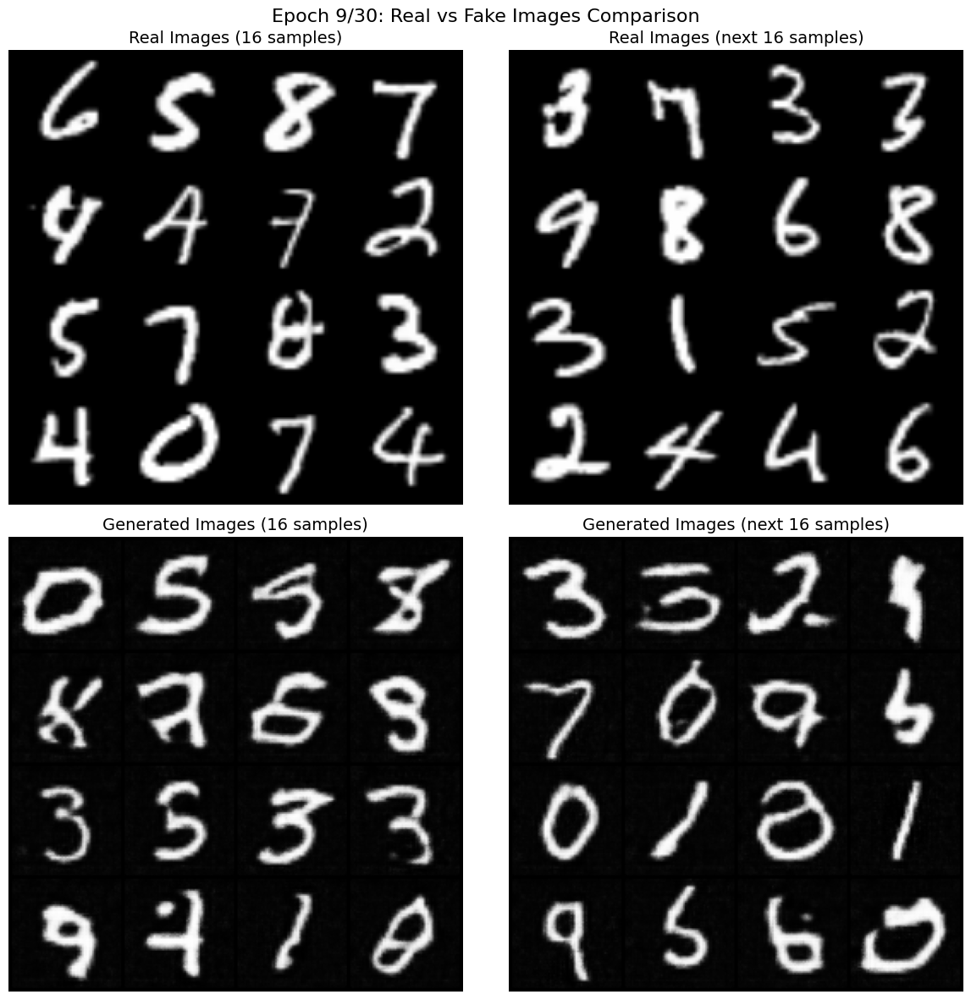

Epoch 9 Summary:
  Average Generator Loss: 1.3590
  Average Discriminator Loss: 1.1252
  D(real_images): 0.7247 (should be close to 1, or real_label_smooth)
  D(fake_images): 0.3269 (should be close to 0, or fake_label_smooth)
  🟡 Training dynamics look reasonable
  Total iterations completed: 4221
--------------------------------------------------
[9/30][0/469]	Loss_D: 0.9849	Loss_G: 1.8484	D(x): 0.8122	D(G(z)): 0.2893 / 0.1248
[9/30][50/469]	Loss_D: 0.9874	Loss_G: 1.2239	D(x): 0.7818	D(G(z)): 0.2892 / 0.2602
[9/30][100/469]	Loss_D: 1.3012	Loss_G: 2.6268	D(x): 0.9149	D(G(z)): 0.5780 / 0.0502
[9/30][150/469]	Loss_D: 1.0521	Loss_G: 1.1271	D(x): 0.6669	D(G(z)): 0.2415 / 0.2968
[9/30][200/469]	Loss_D: 1.0656	Loss_G: 1.4412	D(x): 0.8012	D(G(z)): 0.4108 / 0.2019
[9/30][250/469]	Loss_D: 1.0347	Loss_G: 1.6201	D(x): 0.7849	D(G(z)): 0.3747 / 0.1604
[9/30][300/469]	Loss_D: 1.0248	Loss_G: 0.9725	D(x): 0.6947	D(G(z)): 0.2210 / 0.3557
[9/30][350/469]	Loss_D: 1.1136	Loss_G: 0.7811	D(x): 0.5886	D(G(z

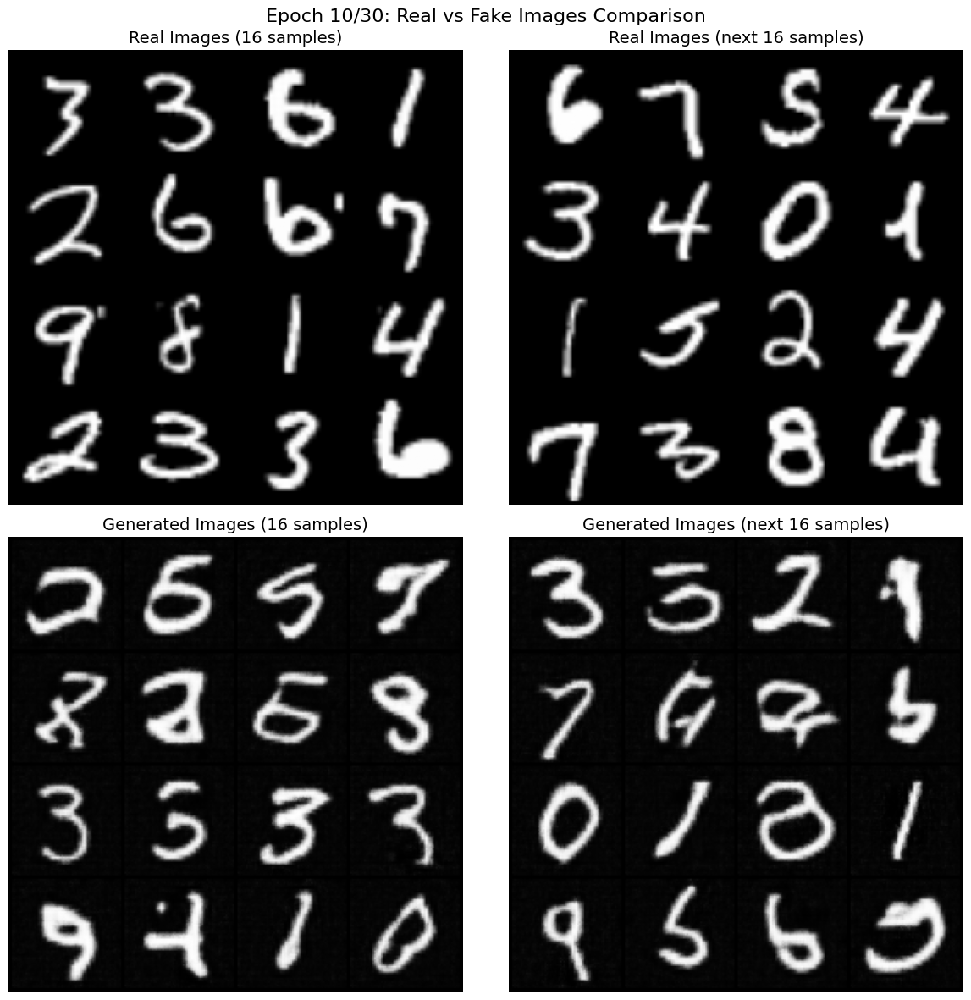

Epoch 10 Summary:
  Average Generator Loss: 1.3557
  Average Discriminator Loss: 1.1208
  D(real_images): 0.7261 (should be close to 1, or real_label_smooth)
  D(fake_images): 0.3253 (should be close to 0, or fake_label_smooth)
  🟡 Training dynamics look reasonable
  Total iterations completed: 4690
--------------------------------------------------
[10/30][0/469]	Loss_D: 1.0066	Loss_G: 1.1322	D(x): 0.7831	D(G(z)): 0.3235 / 0.2891
[10/30][50/469]	Loss_D: 1.1688	Loss_G: 1.2719	D(x): 0.5729	D(G(z)): 0.2649 / 0.2515
[10/30][100/469]	Loss_D: 1.0366	Loss_G: 1.0219	D(x): 0.6655	D(G(z)): 0.2086 / 0.3327
[10/30][150/469]	Loss_D: 0.9936	Loss_G: 1.7081	D(x): 0.8141	D(G(z)): 0.3263 / 0.1446
[10/30][200/469]	Loss_D: 0.9798	Loss_G: 1.2068	D(x): 0.7585	D(G(z)): 0.2415 / 0.2656
[10/30][250/469]	Loss_D: 0.9907	Loss_G: 1.1434	D(x): 0.7324	D(G(z)): 0.2368 / 0.2853
[10/30][300/469]	Loss_D: 0.9945	Loss_G: 1.3564	D(x): 0.7797	D(G(z)): 0.3089 / 0.2202
[10/30][350/469]	Loss_D: 1.0200	Loss_G: 0.9458	D(x): 0.6

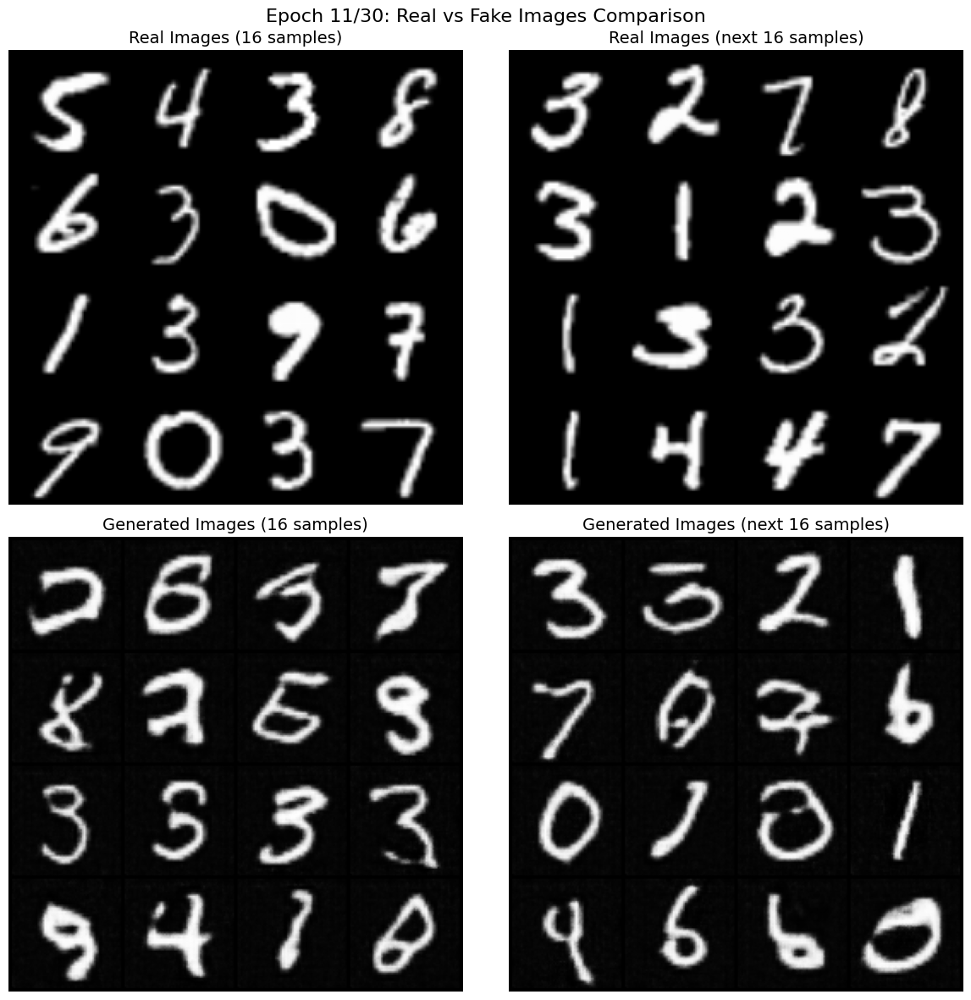

Epoch 11 Summary:
  Average Generator Loss: 1.3524
  Average Discriminator Loss: 1.1154
  D(real_images): 0.7284 (should be close to 1, or real_label_smooth)
  D(fake_images): 0.3229 (should be close to 0, or fake_label_smooth)
  🟡 Training dynamics look reasonable
  Total iterations completed: 5159
--------------------------------------------------
[11/30][0/469]	Loss_D: 1.0065	Loss_G: 1.3054	D(x): 0.7532	D(G(z)): 0.2771 / 0.2398
[11/30][50/469]	Loss_D: 1.0244	Loss_G: 1.2841	D(x): 0.8091	D(G(z)): 0.3710 / 0.2409
[11/30][100/469]	Loss_D: 1.0239	Loss_G: 0.9909	D(x): 0.6850	D(G(z)): 0.2185 / 0.3479
[11/30][150/469]	Loss_D: 1.0453	Loss_G: 1.1800	D(x): 0.6971	D(G(z)): 0.2879 / 0.2764
[11/30][200/469]	Loss_D: 1.0301	Loss_G: 1.2274	D(x): 0.6937	D(G(z)): 0.2463 / 0.2584
[11/30][250/469]	Loss_D: 1.2328	Loss_G: 1.8392	D(x): 0.8972	D(G(z)): 0.5458 / 0.1264
[11/30][300/469]	Loss_D: 1.0509	Loss_G: 1.8408	D(x): 0.8431	D(G(z)): 0.4037 / 0.1245
[11/30][350/469]	Loss_D: 1.0218	Loss_G: 1.3016	D(x): 0.6

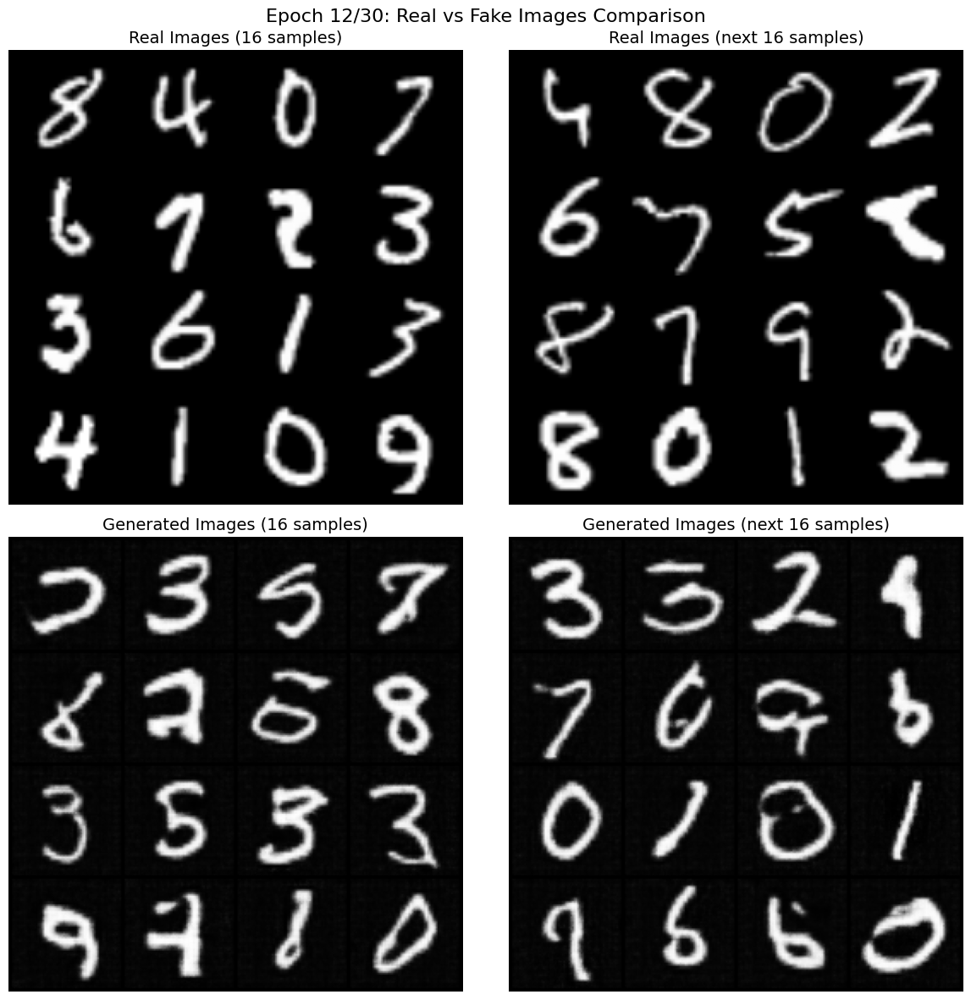

Epoch 12 Summary:
  Average Generator Loss: 1.3510
  Average Discriminator Loss: 1.1111
  D(real_images): 0.7303 (should be close to 1, or real_label_smooth)
  D(fake_images): 0.3209 (should be close to 0, or fake_label_smooth)
  🟡 Training dynamics look reasonable
  Total iterations completed: 5628
--------------------------------------------------
[12/30][0/469]	Loss_D: 1.0605	Loss_G: 0.8457	D(x): 0.6541	D(G(z)): 0.1415 / 0.4157
[12/30][50/469]	Loss_D: 1.0283	Loss_G: 1.5409	D(x): 0.8267	D(G(z)): 0.3776 / 0.1764
[12/30][100/469]	Loss_D: 1.0129	Loss_G: 1.7019	D(x): 0.8429	D(G(z)): 0.3665 / 0.1461
[12/30][150/469]	Loss_D: 1.1098	Loss_G: 1.3623	D(x): 0.7639	D(G(z)): 0.4349 / 0.2213
[12/30][200/469]	Loss_D: 1.0504	Loss_G: 1.1702	D(x): 0.6813	D(G(z)): 0.2976 / 0.2773
[12/30][250/469]	Loss_D: 1.0025	Loss_G: 1.5337	D(x): 0.7552	D(G(z)): 0.2989 / 0.1773
[12/30][300/469]	Loss_D: 1.0438	Loss_G: 1.0256	D(x): 0.6793	D(G(z)): 0.2686 / 0.3337
[12/30][350/469]	Loss_D: 1.5060	Loss_G: 0.4516	D(x): 0.3

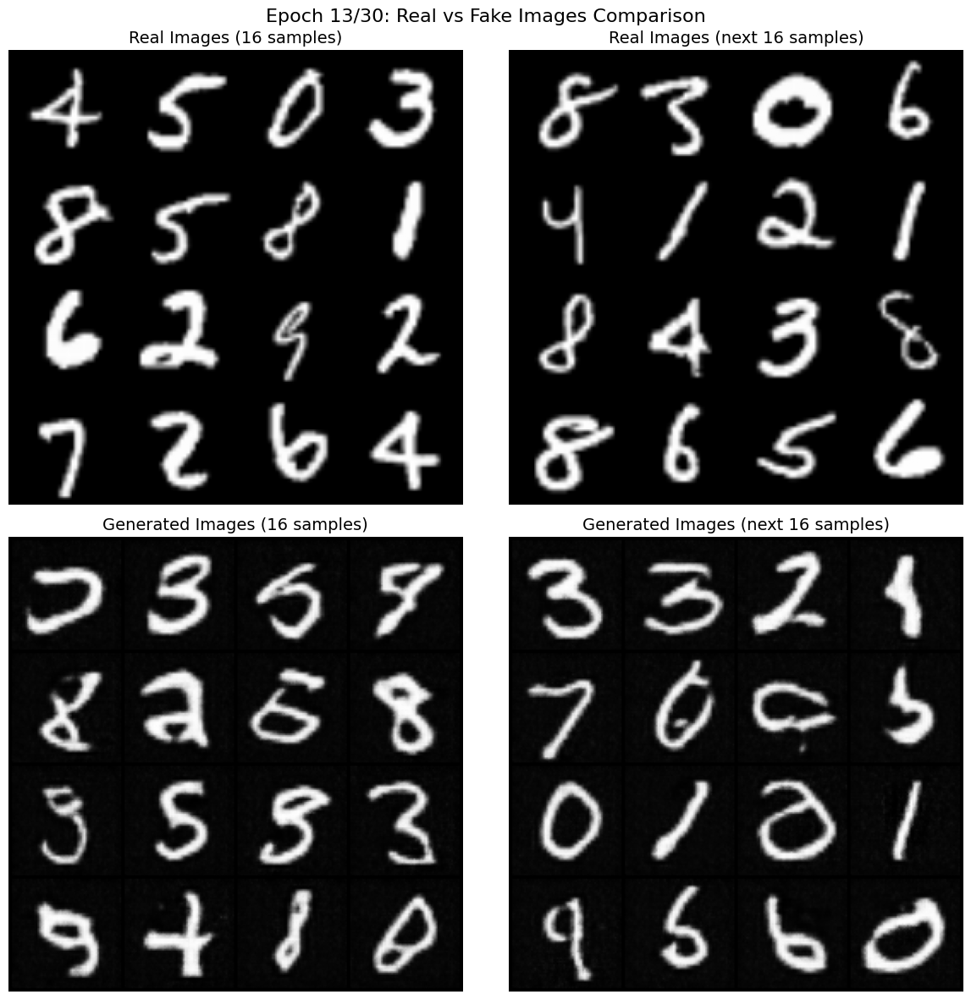

Epoch 13 Summary:
  Average Generator Loss: 1.3500
  Average Discriminator Loss: 1.1085
  D(real_images): 0.7315 (should be close to 1, or real_label_smooth)
  D(fake_images): 0.3196 (should be close to 0, or fake_label_smooth)
  🟡 Training dynamics look reasonable
  Total iterations completed: 6097
--------------------------------------------------
[13/30][0/469]	Loss_D: 1.1253	Loss_G: 1.5500	D(x): 0.8551	D(G(z)): 0.4788 / 0.1750
[13/30][50/469]	Loss_D: 1.1031	Loss_G: 1.4444	D(x): 0.8679	D(G(z)): 0.4591 / 0.1993
[13/30][100/469]	Loss_D: 0.9935	Loss_G: 1.3803	D(x): 0.7989	D(G(z)): 0.3151 / 0.2135
[13/30][150/469]	Loss_D: 0.9623	Loss_G: 1.5287	D(x): 0.8461	D(G(z)): 0.2736 / 0.1785
[13/30][200/469]	Loss_D: 0.9565	Loss_G: 1.2293	D(x): 0.8099	D(G(z)): 0.1685 / 0.2567
[13/30][250/469]	Loss_D: 1.2188	Loss_G: 2.0384	D(x): 0.9267	D(G(z)): 0.5163 / 0.1001
[13/30][300/469]	Loss_D: 1.0368	Loss_G: 1.0087	D(x): 0.6822	D(G(z)): 0.1413 / 0.3389
[13/30][350/469]	Loss_D: 0.9768	Loss_G: 1.3410	D(x): 0.7

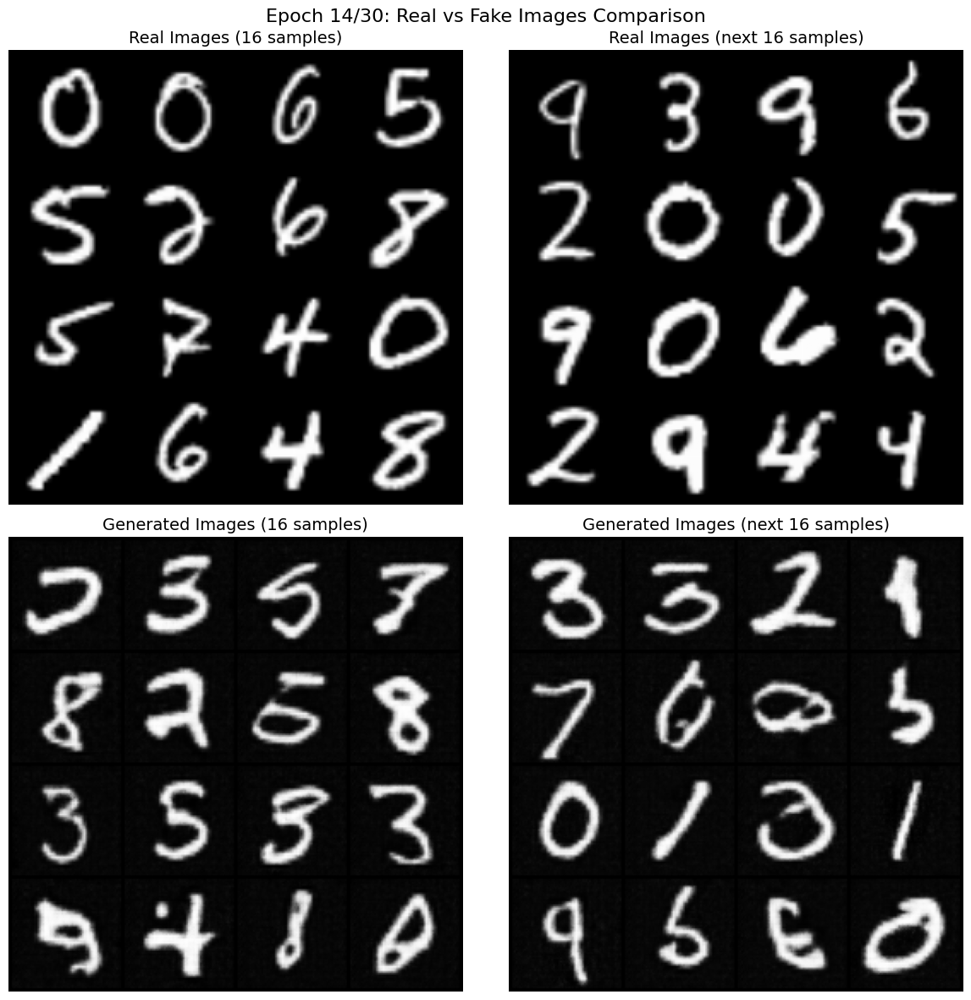

Epoch 14 Summary:
  Average Generator Loss: 1.3504
  Average Discriminator Loss: 1.1038
  D(real_images): 0.7339 (should be close to 1, or real_label_smooth)
  D(fake_images): 0.3171 (should be close to 0, or fake_label_smooth)
  🟡 Training dynamics look reasonable
  Total iterations completed: 6566
--------------------------------------------------
[14/30][0/469]	Loss_D: 1.2263	Loss_G: 2.0316	D(x): 0.9290	D(G(z)): 0.5339 / 0.0976
[14/30][50/469]	Loss_D: 1.0674	Loss_G: 0.7484	D(x): 0.6353	D(G(z)): 0.1652 / 0.4770
[14/30][100/469]	Loss_D: 0.9616	Loss_G: 1.3462	D(x): 0.7913	D(G(z)): 0.2328 / 0.2228
[14/30][150/469]	Loss_D: 0.9522	Loss_G: 1.5244	D(x): 0.8326	D(G(z)): 0.2485 / 0.1788
[14/30][200/469]	Loss_D: 0.9854	Loss_G: 1.1437	D(x): 0.7411	D(G(z)): 0.1974 / 0.2853
[14/30][250/469]	Loss_D: 1.0846	Loss_G: 0.9306	D(x): 0.6241	D(G(z)): 0.1524 / 0.3751
[14/30][300/469]	Loss_D: 0.9627	Loss_G: 1.4938	D(x): 0.8455	D(G(z)): 0.2783 / 0.1866
[14/30][350/469]	Loss_D: 1.0952	Loss_G: 2.0051	D(x): 0.9

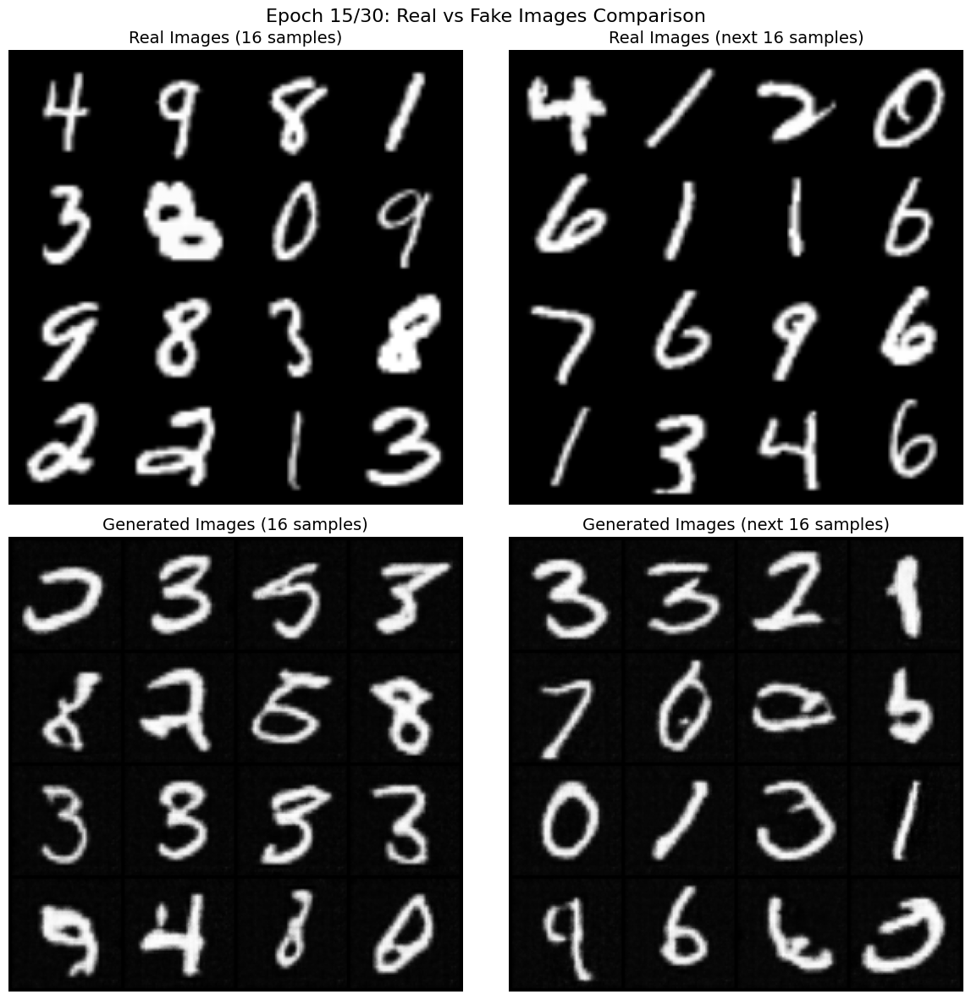

Epoch 15 Summary:
  Average Generator Loss: 1.3521
  Average Discriminator Loss: 1.0995
  D(real_images): 0.7360 (should be close to 1, or real_label_smooth)
  D(fake_images): 0.3149 (should be close to 0, or fake_label_smooth)
  🟡 Training dynamics look reasonable
  Total iterations completed: 7035
--------------------------------------------------
[15/30][0/469]	Loss_D: 1.0593	Loss_G: 1.7445	D(x): 0.8677	D(G(z)): 0.4172 / 0.1390
[15/30][50/469]	Loss_D: 1.0537	Loss_G: 1.3468	D(x): 0.8336	D(G(z)): 0.4008 / 0.2248
[15/30][100/469]	Loss_D: 1.1977	Loss_G: 0.7537	D(x): 0.5270	D(G(z)): 0.1826 / 0.4742
[15/30][150/469]	Loss_D: 1.0694	Loss_G: 1.6710	D(x): 0.8348	D(G(z)): 0.4230 / 0.1530
[15/30][200/469]	Loss_D: 0.9661	Loss_G: 1.2421	D(x): 0.7736	D(G(z)): 0.2218 / 0.2527
[15/30][250/469]	Loss_D: 1.0361	Loss_G: 0.9193	D(x): 0.6797	D(G(z)): 0.2639 / 0.3792
[15/30][300/469]	Loss_D: 0.9718	Loss_G: 1.3600	D(x): 0.7897	D(G(z)): 0.2735 / 0.2178
[15/30][350/469]	Loss_D: 0.9806	Loss_G: 1.3450	D(x): 0.7

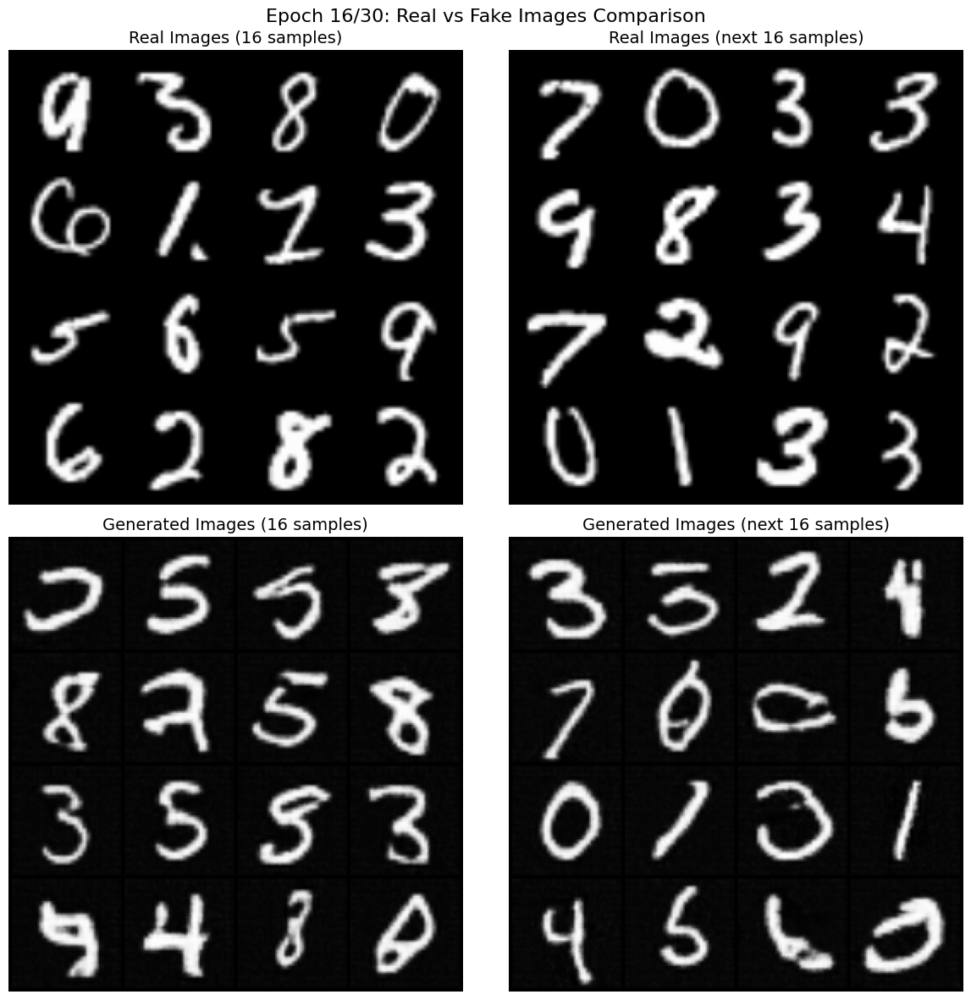

Epoch 16 Summary:
  Average Generator Loss: 1.3520
  Average Discriminator Loss: 1.0973
  D(real_images): 0.7371 (should be close to 1, or real_label_smooth)
  D(fake_images): 0.3138 (should be close to 0, or fake_label_smooth)
  🟡 Training dynamics look reasonable
  Total iterations completed: 7504
--------------------------------------------------
[16/30][0/469]	Loss_D: 0.9498	Loss_G: 1.2492	D(x): 0.7983	D(G(z)): 0.2073 / 0.2486
[16/30][50/469]	Loss_D: 1.1150	Loss_G: 0.8338	D(x): 0.6603	D(G(z)): 0.0788 / 0.4268
[16/30][100/469]	Loss_D: 1.0256	Loss_G: 0.9072	D(x): 0.6946	D(G(z)): 0.1397 / 0.3840
[16/30][150/469]	Loss_D: 1.1208	Loss_G: 0.9664	D(x): 0.6052	D(G(z)): 0.2629 / 0.3579
[16/30][200/469]	Loss_D: 0.9864	Loss_G: 1.1427	D(x): 0.7350	D(G(z)): 0.2021 / 0.2844
[16/30][250/469]	Loss_D: 1.0503	Loss_G: 0.9128	D(x): 0.6472	D(G(z)): 0.2237 / 0.3803
[16/30][300/469]	Loss_D: 0.9520	Loss_G: 1.6587	D(x): 0.8625	D(G(z)): 0.2511 / 0.1528
[16/30][350/469]	Loss_D: 1.0146	Loss_G: 1.7095	D(x): 0.8

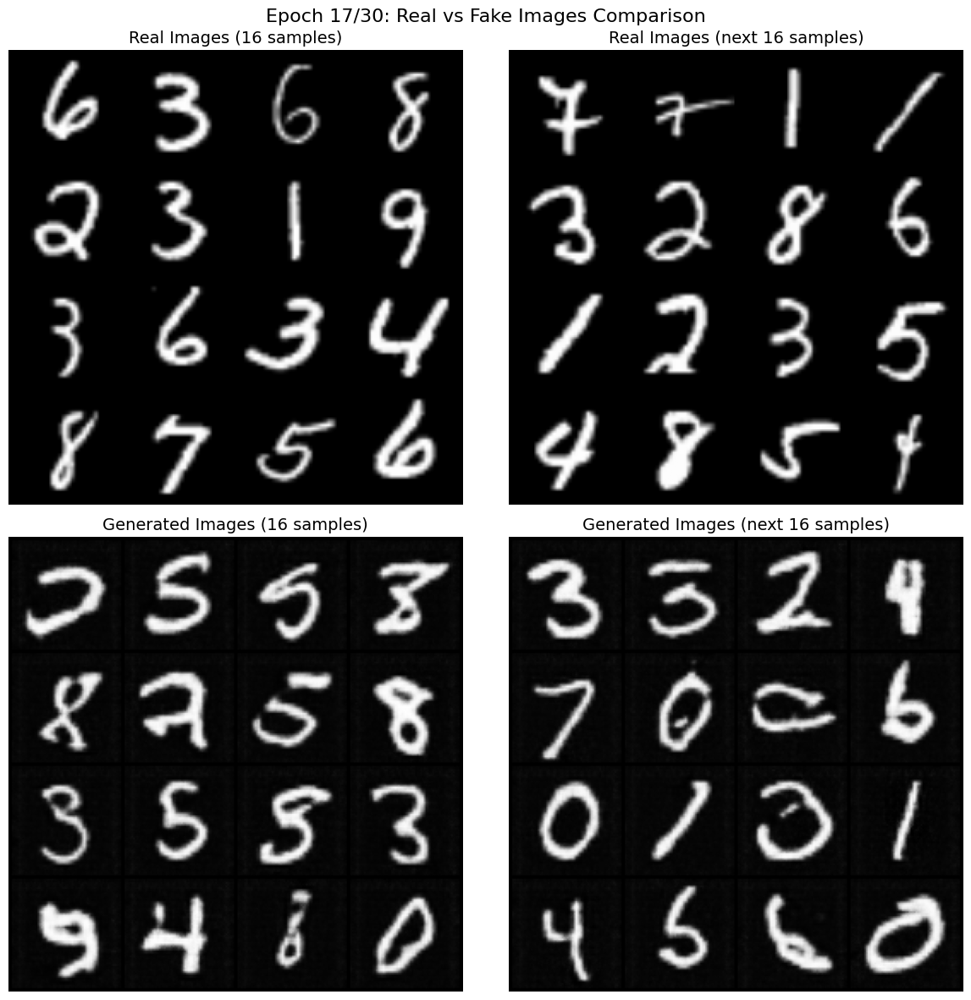

Epoch 17 Summary:
  Average Generator Loss: 1.3520
  Average Discriminator Loss: 1.0946
  D(real_images): 0.7388 (should be close to 1, or real_label_smooth)
  D(fake_images): 0.3121 (should be close to 0, or fake_label_smooth)
  🟡 Training dynamics look reasonable
  Total iterations completed: 7973
--------------------------------------------------
[17/30][0/469]	Loss_D: 1.0448	Loss_G: 1.0118	D(x): 0.7036	D(G(z)): 0.1042 / 0.3346
[17/30][50/469]	Loss_D: 1.1484	Loss_G: 1.8344	D(x): 0.9054	D(G(z)): 0.4879 / 0.1245
[17/30][100/469]	Loss_D: 0.9522	Loss_G: 1.4237	D(x): 0.8314	D(G(z)): 0.2440 / 0.2022
[17/30][150/469]	Loss_D: 1.4671	Loss_G: 0.6655	D(x): 0.3767	D(G(z)): 0.2138 / 0.5429
[17/30][200/469]	Loss_D: 1.0235	Loss_G: 0.9850	D(x): 0.6844	D(G(z)): 0.1878 / 0.3478
[17/30][250/469]	Loss_D: 1.0241	Loss_G: 1.4322	D(x): 0.8273	D(G(z)): 0.3723 / 0.2031
[17/30][300/469]	Loss_D: 1.0190	Loss_G: 1.2222	D(x): 0.7018	D(G(z)): 0.2632 / 0.2592
[17/30][350/469]	Loss_D: 1.0048	Loss_G: 1.6253	D(x): 0.8

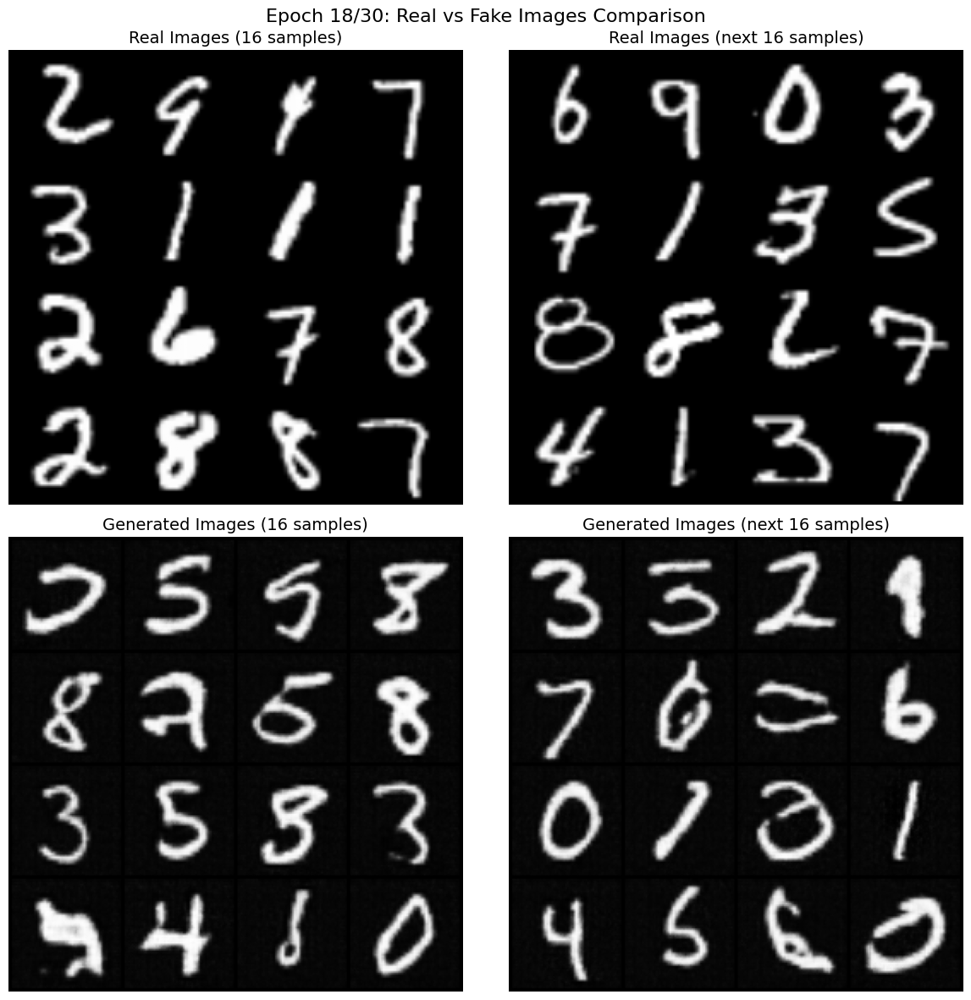

Epoch 18 Summary:
  Average Generator Loss: 1.3542
  Average Discriminator Loss: 1.0916
  D(real_images): 0.7405 (should be close to 1, or real_label_smooth)
  D(fake_images): 0.3104 (should be close to 0, or fake_label_smooth)
  🟡 Training dynamics look reasonable
  Total iterations completed: 8442
--------------------------------------------------
[18/30][0/469]	Loss_D: 1.1474	Loss_G: 0.8384	D(x): 0.5932	D(G(z)): 0.1100 / 0.4237
[18/30][50/469]	Loss_D: 0.9600	Loss_G: 1.1588	D(x): 0.7786	D(G(z)): 0.1886 / 0.2798
[18/30][100/469]	Loss_D: 1.0068	Loss_G: 0.9999	D(x): 0.7108	D(G(z)): 0.1502 / 0.3392
[18/30][150/469]	Loss_D: 1.0712	Loss_G: 0.8463	D(x): 0.6599	D(G(z)): 0.1096 / 0.4158
[18/30][200/469]	Loss_D: 0.9554	Loss_G: 1.2641	D(x): 0.7907	D(G(z)): 0.1899 / 0.2453
[18/30][250/469]	Loss_D: 1.0239	Loss_G: 1.3811	D(x): 0.8079	D(G(z)): 0.3649 / 0.2157
[18/30][300/469]	Loss_D: 0.9510	Loss_G: 1.2628	D(x): 0.8005	D(G(z)): 0.1912 / 0.2452
[18/30][350/469]	Loss_D: 0.9640	Loss_G: 1.3548	D(x): 0.8

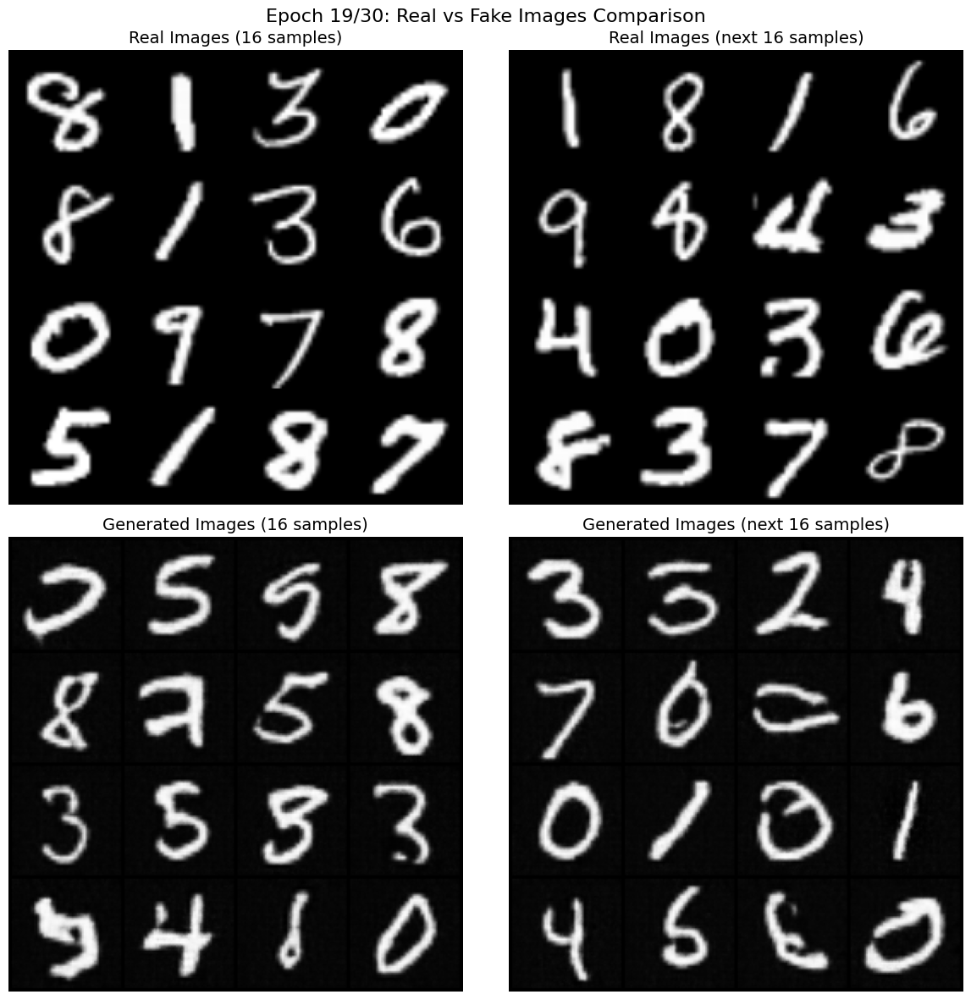

Epoch 19 Summary:
  Average Generator Loss: 1.3556
  Average Discriminator Loss: 1.0881
  D(real_images): 0.7424 (should be close to 1, or real_label_smooth)
  D(fake_images): 0.3084 (should be close to 0, or fake_label_smooth)
  🟡 Training dynamics look reasonable
  Total iterations completed: 8911
--------------------------------------------------
[19/30][0/469]	Loss_D: 0.9586	Loss_G: 1.4919	D(x): 0.8459	D(G(z)): 0.2792 / 0.1849
[19/30][50/469]	Loss_D: 1.0047	Loss_G: 1.0605	D(x): 0.7027	D(G(z)): 0.2194 / 0.3177
[19/30][100/469]	Loss_D: 0.9540	Loss_G: 1.4287	D(x): 0.8605	D(G(z)): 0.2659 / 0.1997
[19/30][150/469]	Loss_D: 1.6409	Loss_G: 0.5825	D(x): 0.3110	D(G(z)): 0.2689 / 0.6086
[19/30][200/469]	Loss_D: 1.0142	Loss_G: 1.2345	D(x): 0.7366	D(G(z)): 0.3056 / 0.2555
[19/30][250/469]	Loss_D: 0.9672	Loss_G: 1.2264	D(x): 0.7763	D(G(z)): 0.2418 / 0.2563
[19/30][300/469]	Loss_D: 1.0051	Loss_G: 1.2158	D(x): 0.7057	D(G(z)): 0.2262 / 0.2603
[19/30][350/469]	Loss_D: 1.0446	Loss_G: 0.9558	D(x): 0.6

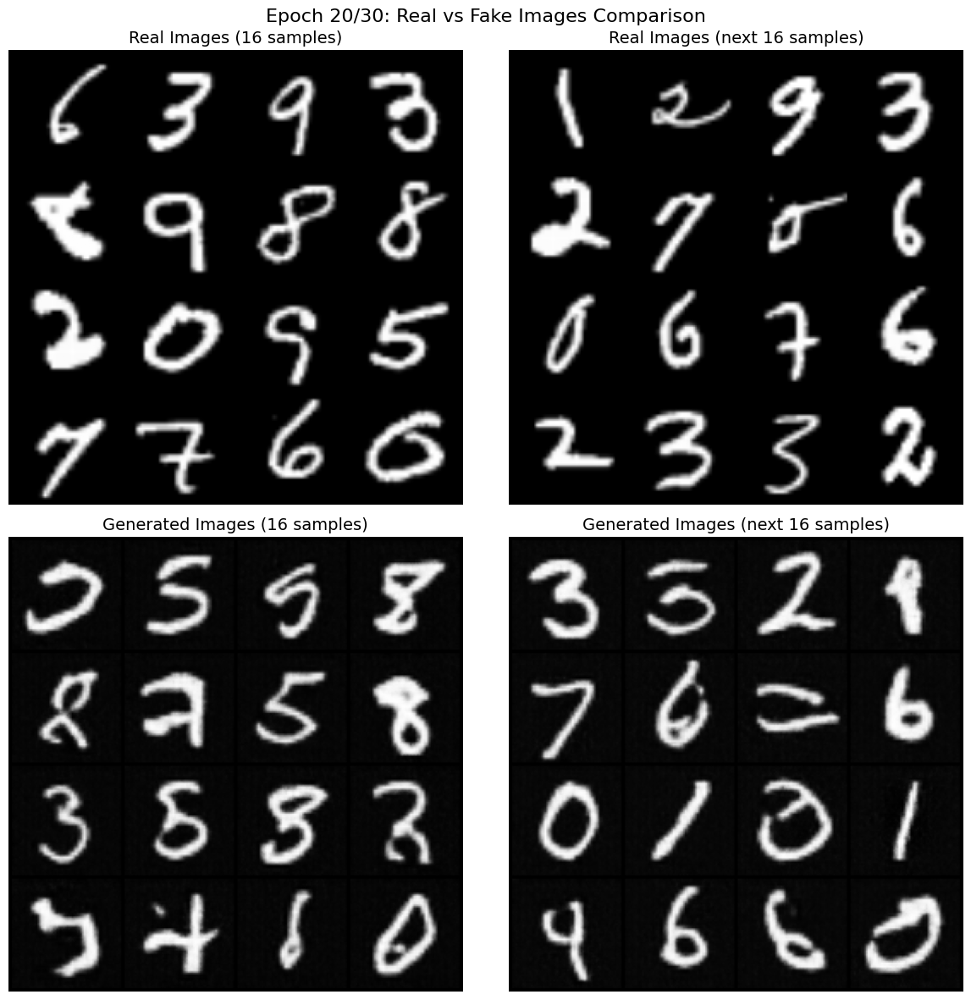

Epoch 20 Summary:
  Average Generator Loss: 1.3563
  Average Discriminator Loss: 1.0864
  D(real_images): 0.7435 (should be close to 1, or real_label_smooth)
  D(fake_images): 0.3073 (should be close to 0, or fake_label_smooth)
  🟡 Training dynamics look reasonable
  Total iterations completed: 9380
--------------------------------------------------
[20/30][0/469]	Loss_D: 0.9887	Loss_G: 1.4972	D(x): 0.8512	D(G(z)): 0.3295 / 0.1852
[20/30][50/469]	Loss_D: 0.9765	Loss_G: 1.3160	D(x): 0.7766	D(G(z)): 0.2678 / 0.2322
[20/30][100/469]	Loss_D: 1.1146	Loss_G: 0.7809	D(x): 0.6089	D(G(z)): 0.1204 / 0.4551
[20/30][150/469]	Loss_D: 0.9822	Loss_G: 1.3925	D(x): 0.7517	D(G(z)): 0.2526 / 0.2092
[20/30][200/469]	Loss_D: 1.0357	Loss_G: 1.0527	D(x): 0.6721	D(G(z)): 0.1525 / 0.3211
[20/30][250/469]	Loss_D: 0.9596	Loss_G: 1.4537	D(x): 0.8034	D(G(z)): 0.2551 / 0.1953
[20/30][300/469]	Loss_D: 0.9693	Loss_G: 1.5444	D(x): 0.8206	D(G(z)): 0.2902 / 0.1742
[20/30][350/469]	Loss_D: 0.9929	Loss_G: 0.9168	D(x): 0.7

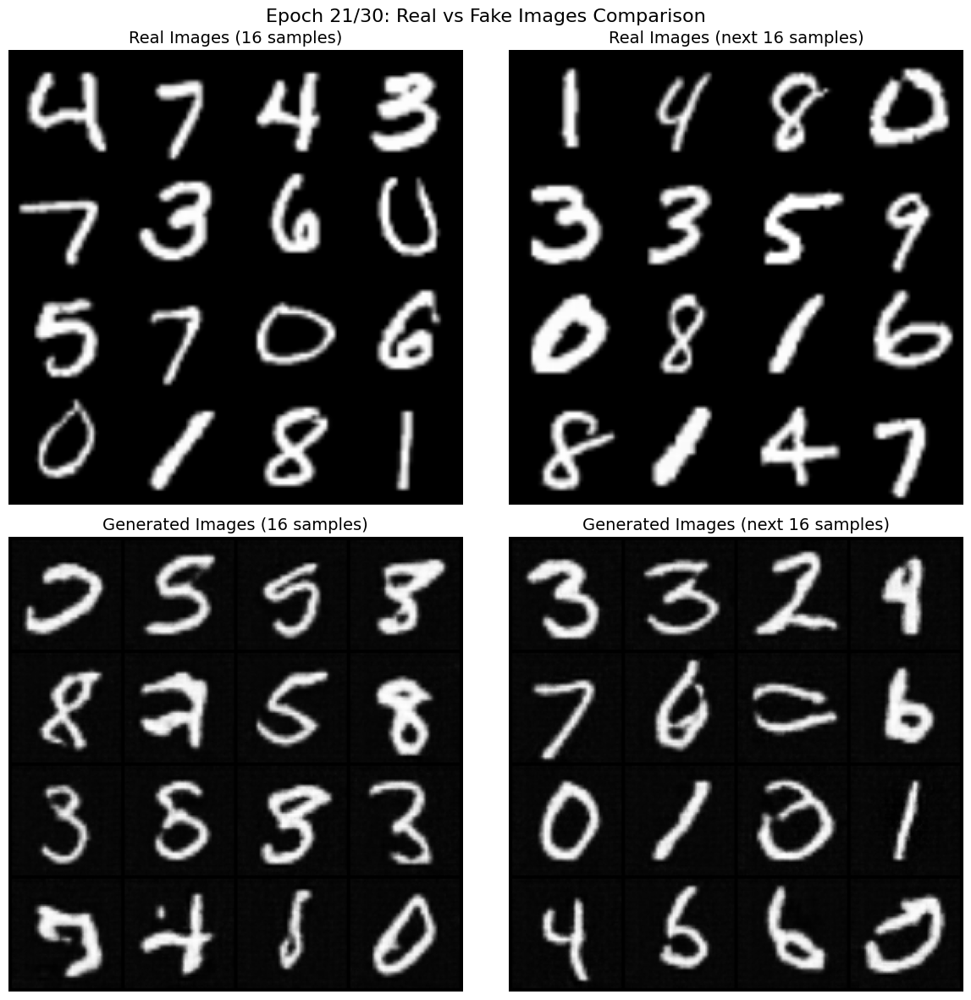

Epoch 21 Summary:
  Average Generator Loss: 1.3585
  Average Discriminator Loss: 1.0832
  D(real_images): 0.7453 (should be close to 1, or real_label_smooth)
  D(fake_images): 0.3054 (should be close to 0, or fake_label_smooth)
  🟡 Training dynamics look reasonable
  Total iterations completed: 9849
--------------------------------------------------
[21/30][0/469]	Loss_D: 0.9510	Loss_G: 1.5843	D(x): 0.8274	D(G(z)): 0.2452 / 0.1661
[21/30][50/469]	Loss_D: 1.1171	Loss_G: 2.2764	D(x): 0.9019	D(G(z)): 0.4706 / 0.0742
[21/30][100/469]	Loss_D: 0.9481	Loss_G: 1.3738	D(x): 0.8152	D(G(z)): 0.2156 / 0.2144
[21/30][150/469]	Loss_D: 1.0944	Loss_G: 0.8709	D(x): 0.6576	D(G(z)): 0.0900 / 0.4002
[21/30][200/469]	Loss_D: 0.9440	Loss_G: 1.4915	D(x): 0.8346	D(G(z)): 0.2292 / 0.1848
[21/30][250/469]	Loss_D: 0.9462	Loss_G: 1.5818	D(x): 0.8483	D(G(z)): 0.2326 / 0.1658
[21/30][300/469]	Loss_D: 1.1339	Loss_G: 0.9866	D(x): 0.6312	D(G(z)): 0.3564 / 0.3484
[21/30][350/469]	Loss_D: 0.9893	Loss_G: 1.1827	D(x): 0.7

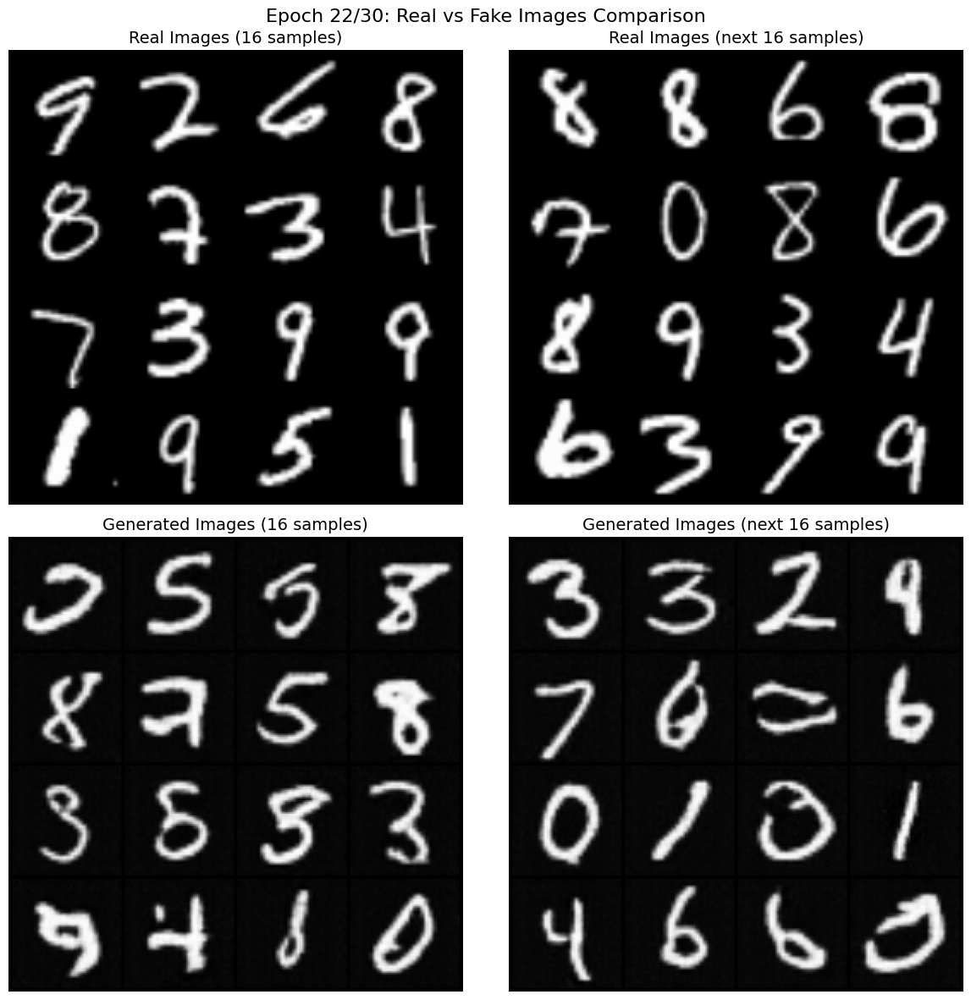

Epoch 22 Summary:
  Average Generator Loss: 1.3599
  Average Discriminator Loss: 1.0811
  D(real_images): 0.7467 (should be close to 1, or real_label_smooth)
  D(fake_images): 0.3039 (should be close to 0, or fake_label_smooth)
  🟡 Training dynamics look reasonable
  Total iterations completed: 10318
--------------------------------------------------
[22/30][0/469]	Loss_D: 1.0940	Loss_G: 0.9962	D(x): 0.6200	D(G(z)): 0.1340 / 0.3459
[22/30][50/469]	Loss_D: 0.9732	Loss_G: 1.1824	D(x): 0.7541	D(G(z)): 0.2130 / 0.2714
[22/30][100/469]	Loss_D: 1.0723	Loss_G: 1.1768	D(x): 0.7595	D(G(z)): 0.4047 / 0.2736
[22/30][150/469]	Loss_D: 1.0321	Loss_G: 0.8601	D(x): 0.6829	D(G(z)): 0.1469 / 0.4094
[22/30][200/469]	Loss_D: 0.9703	Loss_G: 1.1910	D(x): 0.7727	D(G(z)): 0.2591 / 0.2665
[22/30][250/469]	Loss_D: 1.0326	Loss_G: 1.5304	D(x): 0.8728	D(G(z)): 0.3938 / 0.1751
[22/30][300/469]	Loss_D: 1.0063	Loss_G: 2.0137	D(x): 0.8679	D(G(z)): 0.3632 / 0.0985
[22/30][350/469]	Loss_D: 0.9882	Loss_G: 1.5829	D(x): 0.

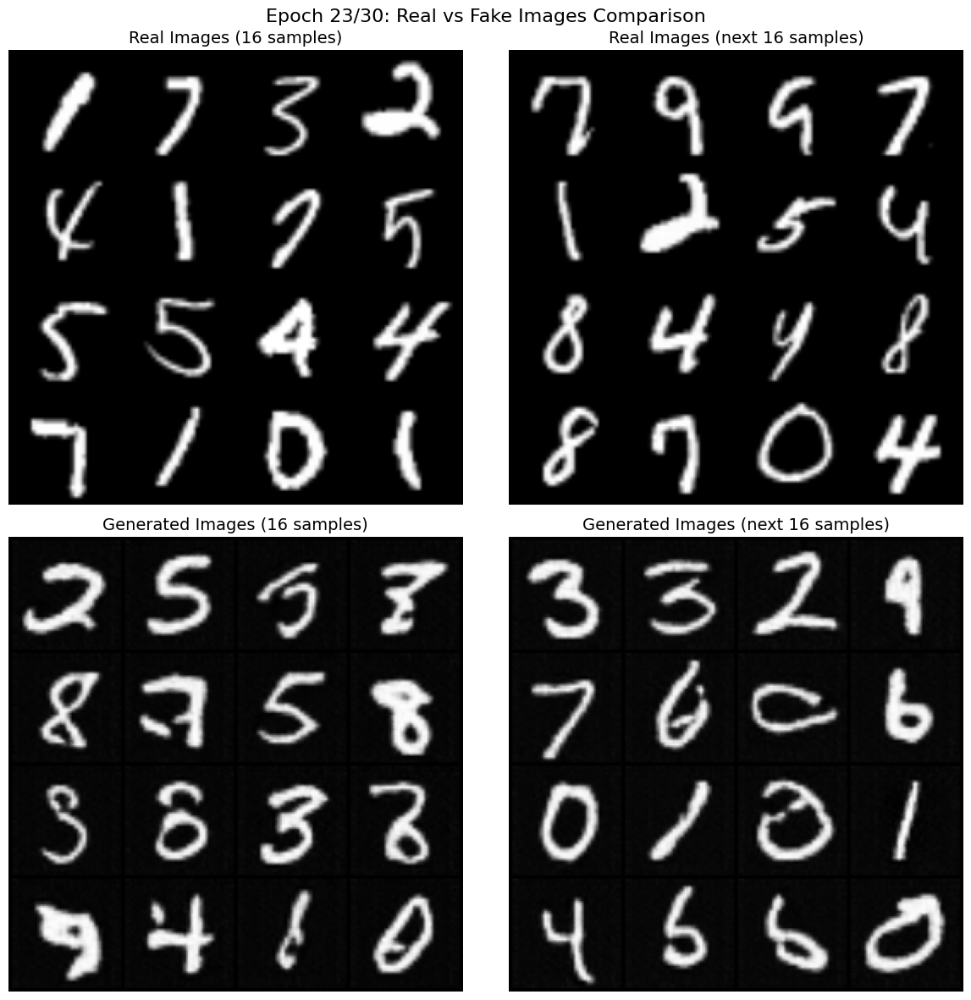

Epoch 23 Summary:
  Average Generator Loss: 1.3619
  Average Discriminator Loss: 1.0783
  D(real_images): 0.7483 (should be close to 1, or real_label_smooth)
  D(fake_images): 0.3023 (should be close to 0, or fake_label_smooth)
  🟡 Training dynamics look reasonable
  Total iterations completed: 10787
--------------------------------------------------
[23/30][0/469]	Loss_D: 0.9632	Loss_G: 1.6696	D(x): 0.8387	D(G(z)): 0.2879 / 0.1502
[23/30][50/469]	Loss_D: 0.9894	Loss_G: 1.1872	D(x): 0.7527	D(G(z)): 0.1309 / 0.2697
[23/30][100/469]	Loss_D: 1.1230	Loss_G: 0.9485	D(x): 0.5758	D(G(z)): 0.2176 / 0.3647
[23/30][150/469]	Loss_D: 0.9654	Loss_G: 1.6706	D(x): 0.8703	D(G(z)): 0.2944 / 0.1493
[23/30][200/469]	Loss_D: 2.6652	Loss_G: 2.1840	D(x): 0.9847	D(G(z)): 0.9028 / 0.0879
[23/30][250/469]	Loss_D: 0.9664	Loss_G: 1.4636	D(x): 0.7733	D(G(z)): 0.2418 / 0.1934
[23/30][300/469]	Loss_D: 0.9492	Loss_G: 1.4005	D(x): 0.8132	D(G(z)): 0.1971 / 0.2075
[23/30][350/469]	Loss_D: 0.9924	Loss_G: 1.1231	D(x): 0.

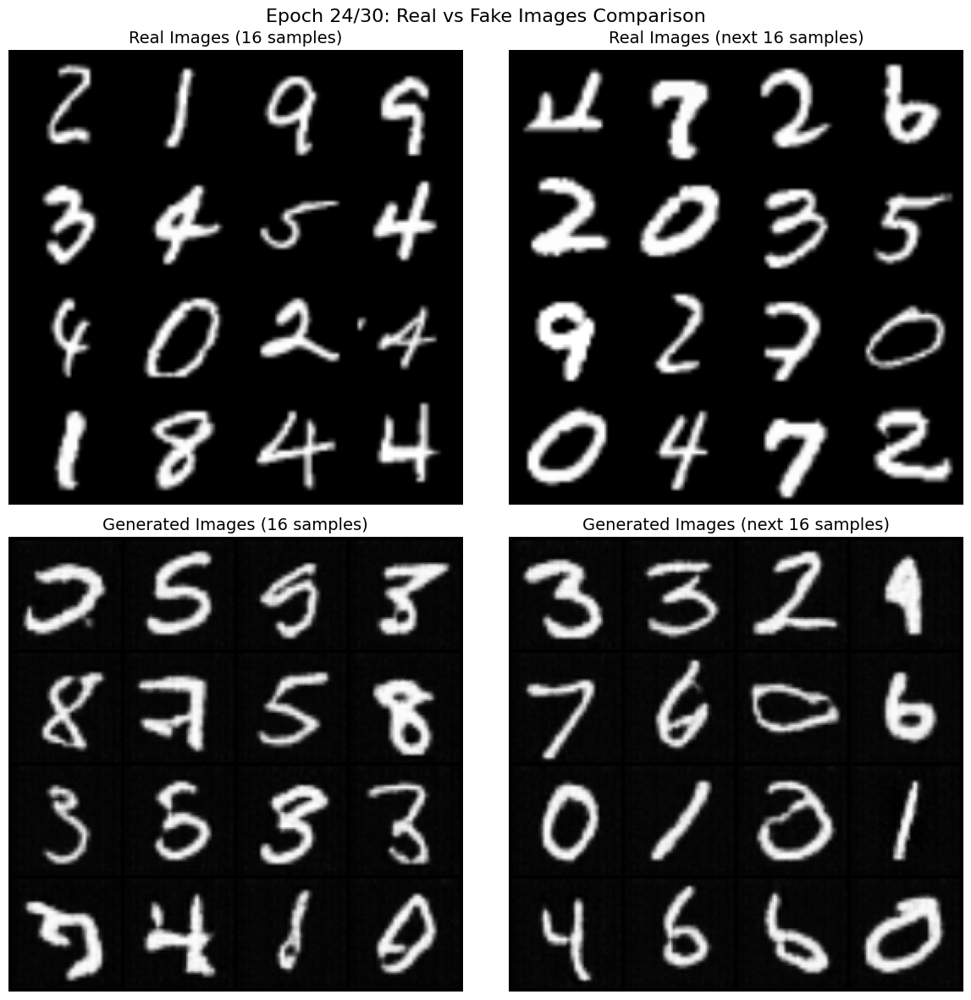

Epoch 24 Summary:
  Average Generator Loss: 1.3636
  Average Discriminator Loss: 1.0763
  D(real_images): 0.7496 (should be close to 1, or real_label_smooth)
  D(fake_images): 0.3010 (should be close to 0, or fake_label_smooth)
  🟡 Training dynamics look reasonable
  Total iterations completed: 11256
--------------------------------------------------
[24/30][0/469]	Loss_D: 1.0701	Loss_G: 1.6100	D(x): 0.7554	D(G(z)): 0.4022 / 0.1624
[24/30][50/469]	Loss_D: 0.9817	Loss_G: 1.8429	D(x): 0.8355	D(G(z)): 0.3227 / 0.1221
[24/30][100/469]	Loss_D: 0.9695	Loss_G: 1.9988	D(x): 0.8846	D(G(z)): 0.3016 / 0.0996
[24/30][150/469]	Loss_D: 1.1500	Loss_G: 0.8358	D(x): 0.5755	D(G(z)): 0.1199 / 0.4255
[24/30][200/469]	Loss_D: 0.9758	Loss_G: 1.5827	D(x): 0.8744	D(G(z)): 0.3155 / 0.1648
[24/30][250/469]	Loss_D: 0.9528	Loss_G: 1.1669	D(x): 0.7888	D(G(z)): 0.1807 / 0.2746
[24/30][300/469]	Loss_D: 1.3598	Loss_G: 0.8908	D(x): 0.5758	D(G(z)): 0.5142 / 0.3931
[24/30][350/469]	Loss_D: 1.0035	Loss_G: 1.1169	D(x): 0.

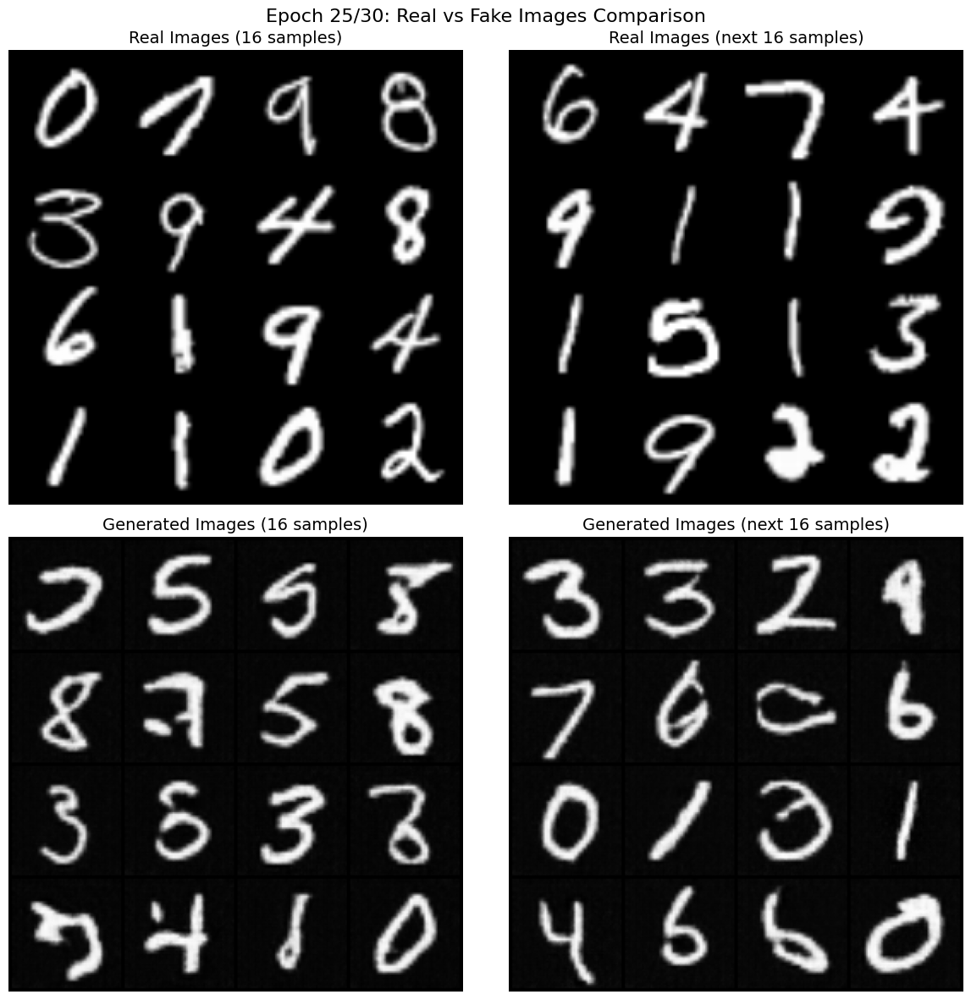

Epoch 25 Summary:
  Average Generator Loss: 1.3637
  Average Discriminator Loss: 1.0750
  D(real_images): 0.7504 (should be close to 1, or real_label_smooth)
  D(fake_images): 0.3001 (should be close to 0, or fake_label_smooth)
  🟡 Training dynamics look reasonable
  Total iterations completed: 11725
--------------------------------------------------
[25/30][0/469]	Loss_D: 0.9975	Loss_G: 1.1972	D(x): 0.8254	D(G(z)): 0.3438 / 0.2646
[25/30][50/469]	Loss_D: 0.9717	Loss_G: 1.0957	D(x): 0.7465	D(G(z)): 0.1946 / 0.2999
[25/30][100/469]	Loss_D: 0.9485	Loss_G: 1.5265	D(x): 0.8342	D(G(z)): 0.2533 / 0.1769
[25/30][150/469]	Loss_D: 0.9769	Loss_G: 1.3401	D(x): 0.7420	D(G(z)): 0.1888 / 0.2229
[25/30][200/469]	Loss_D: 0.9711	Loss_G: 1.5459	D(x): 0.8823	D(G(z)): 0.2996 / 0.1727
[25/30][250/469]	Loss_D: 0.9573	Loss_G: 1.7956	D(x): 0.8665	D(G(z)): 0.2746 / 0.1279
[25/30][300/469]	Loss_D: 0.9613	Loss_G: 1.1155	D(x): 0.7746	D(G(z)): 0.1924 / 0.2939
[25/30][350/469]	Loss_D: 0.9958	Loss_G: 1.7456	D(x): 0.

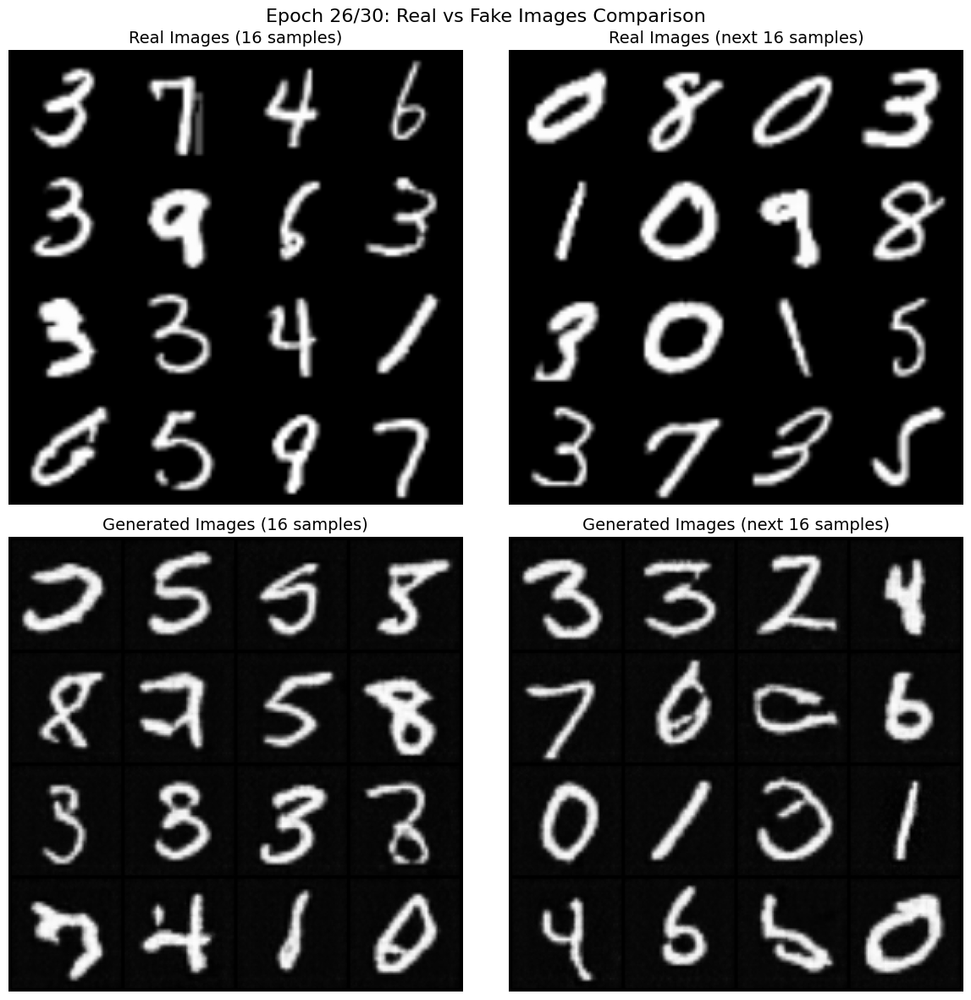

Epoch 26 Summary:
  Average Generator Loss: 1.3652
  Average Discriminator Loss: 1.0721
  D(real_images): 0.7522 (should be close to 1, or real_label_smooth)
  D(fake_images): 0.2984 (should be close to 0, or fake_label_smooth)
  🟢 Discriminator is strong but not overpowering, and G is learning.
  Total iterations completed: 12194
--------------------------------------------------
[26/30][0/469]	Loss_D: 1.0141	Loss_G: 1.0310	D(x): 0.7671	D(G(z)): 0.0955 / 0.3260
[26/30][50/469]	Loss_D: 0.9382	Loss_G: 1.4449	D(x): 0.8467	D(G(z)): 0.2213 / 0.1940
[26/30][100/469]	Loss_D: 1.0385	Loss_G: 1.0206	D(x): 0.6618	D(G(z)): 0.1680 / 0.3309
[26/30][150/469]	Loss_D: 1.2125	Loss_G: 0.8667	D(x): 0.5840	D(G(z)): 0.3870 / 0.4061
[26/30][200/469]	Loss_D: 1.0794	Loss_G: 1.8612	D(x): 0.8934	D(G(z)): 0.4385 / 0.1185
[26/30][250/469]	Loss_D: 0.9781	Loss_G: 1.8945	D(x): 0.8617	D(G(z)): 0.3145 / 0.1151
[26/30][300/469]	Loss_D: 0.9810	Loss_G: 1.1330	D(x): 0.7597	D(G(z)): 0.2783 / 0.2854
[26/30][350/469]	Loss_D:

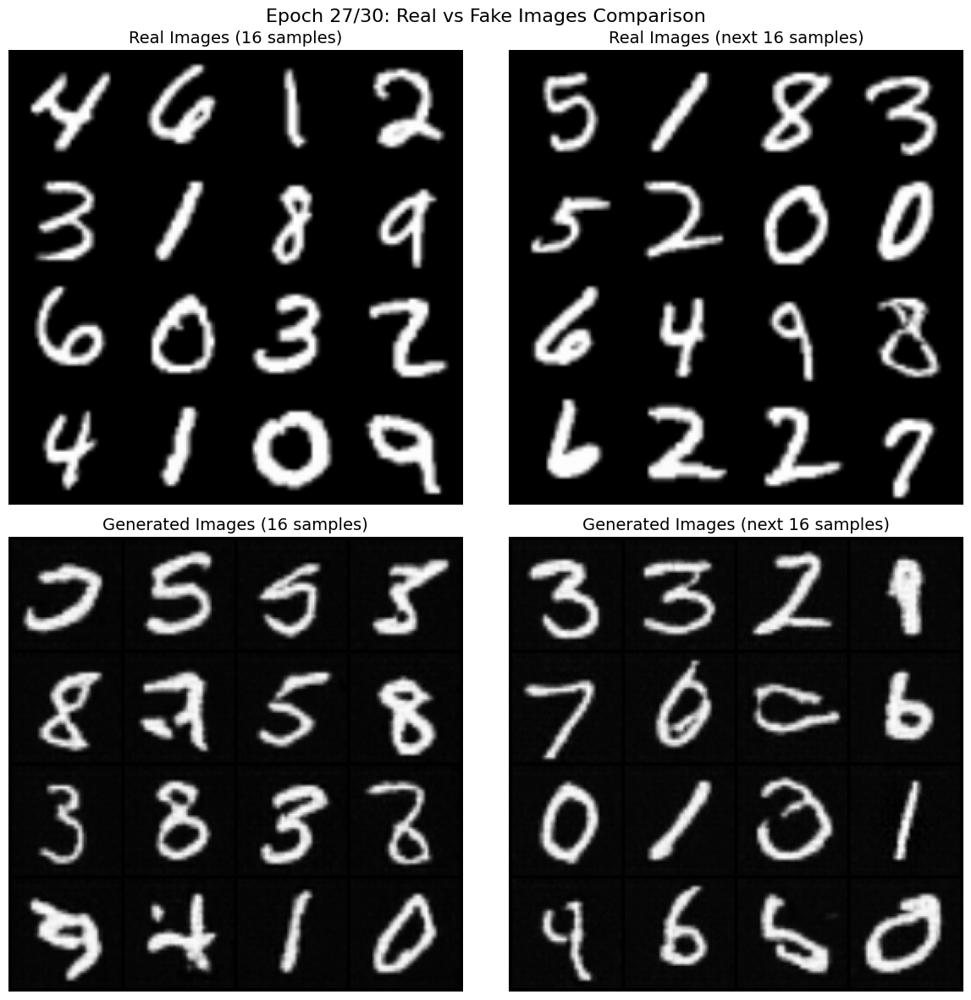

Epoch 27 Summary:
  Average Generator Loss: 1.3663
  Average Discriminator Loss: 1.0702
  D(real_images): 0.7534 (should be close to 1, or real_label_smooth)
  D(fake_images): 0.2972 (should be close to 0, or fake_label_smooth)
  🟢 Discriminator is strong but not overpowering, and G is learning.
  Total iterations completed: 12663
--------------------------------------------------
[27/30][0/469]	Loss_D: 0.9504	Loss_G: 1.2544	D(x): 0.8077	D(G(z)): 0.1596 / 0.2468
[27/30][50/469]	Loss_D: 1.2556	Loss_G: 0.7225	D(x): 0.4820	D(G(z)): 0.2204 / 0.4965
[27/30][100/469]	Loss_D: 0.9650	Loss_G: 1.5702	D(x): 0.8240	D(G(z)): 0.2898 / 0.1686
[27/30][150/469]	Loss_D: 0.9546	Loss_G: 1.5697	D(x): 0.8521	D(G(z)): 0.2776 / 0.1677
[27/30][200/469]	Loss_D: 0.9597	Loss_G: 1.8544	D(x): 0.8495	D(G(z)): 0.2840 / 0.1195
[27/30][250/469]	Loss_D: 1.2473	Loss_G: 1.2325	D(x): 0.6323	D(G(z)): 0.4831 / 0.2560
[27/30][300/469]	Loss_D: 1.0179	Loss_G: 1.1931	D(x): 0.7082	D(G(z)): 0.2575 / 0.2691
[27/30][350/469]	Loss_D:

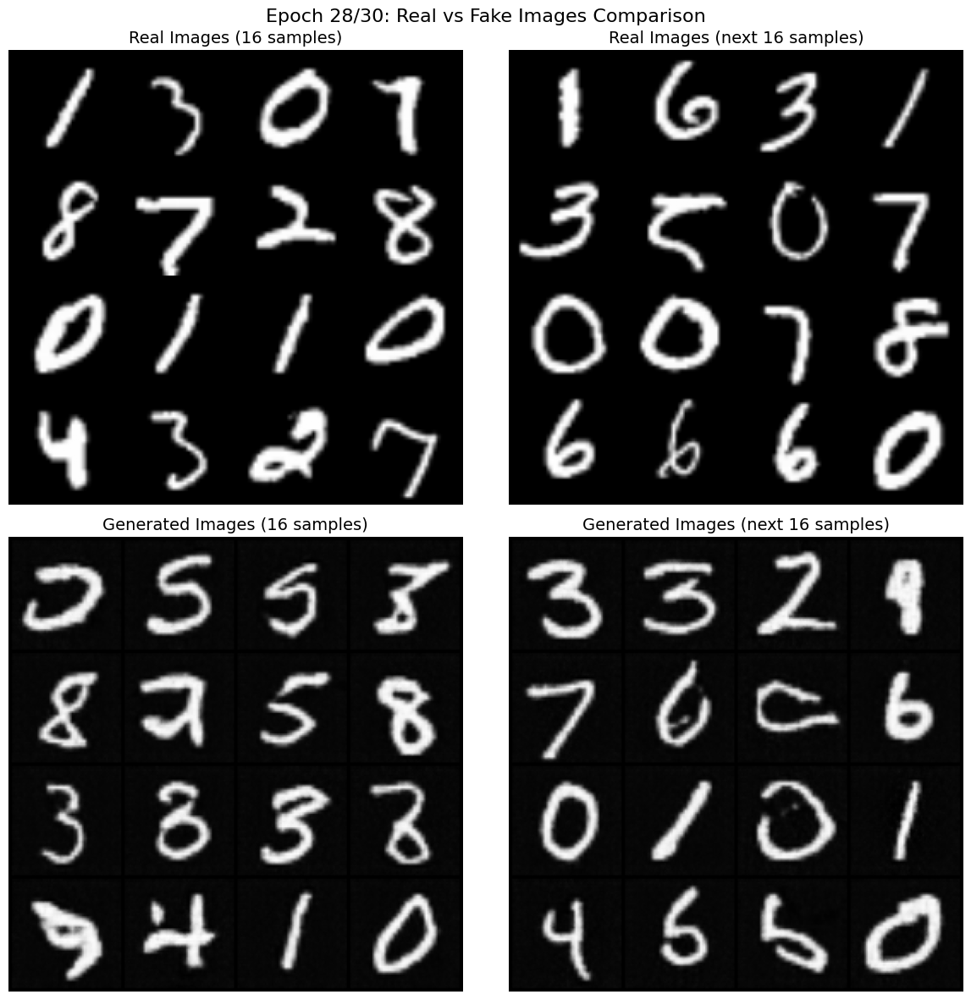

Epoch 28 Summary:
  Average Generator Loss: 1.3674
  Average Discriminator Loss: 1.0688
  D(real_images): 0.7542 (should be close to 1, or real_label_smooth)
  D(fake_images): 0.2963 (should be close to 0, or fake_label_smooth)
  🟢 Discriminator is strong but not overpowering, and G is learning.
  Total iterations completed: 13132
--------------------------------------------------
[28/30][0/469]	Loss_D: 0.9377	Loss_G: 1.3426	D(x): 0.8441	D(G(z)): 0.1874 / 0.2199
[28/30][50/469]	Loss_D: 1.4150	Loss_G: 0.5596	D(x): 0.4048	D(G(z)): 0.1183 / 0.6375
[28/30][100/469]	Loss_D: 0.9654	Loss_G: 1.2513	D(x): 0.7525	D(G(z)): 0.2060 / 0.2460
[28/30][150/469]	Loss_D: 0.9834	Loss_G: 1.1301	D(x): 0.7322	D(G(z)): 0.2143 / 0.2887
[28/30][200/469]	Loss_D: 1.1589	Loss_G: 2.0864	D(x): 0.9313	D(G(z)): 0.4860 / 0.0905
[28/30][250/469]	Loss_D: 0.9948	Loss_G: 1.1587	D(x): 0.7339	D(G(z)): 0.1363 / 0.2781
[28/30][300/469]	Loss_D: 0.9897	Loss_G: 1.7992	D(x): 0.8863	D(G(z)): 0.3379 / 0.1268
[28/30][350/469]	Loss_D:

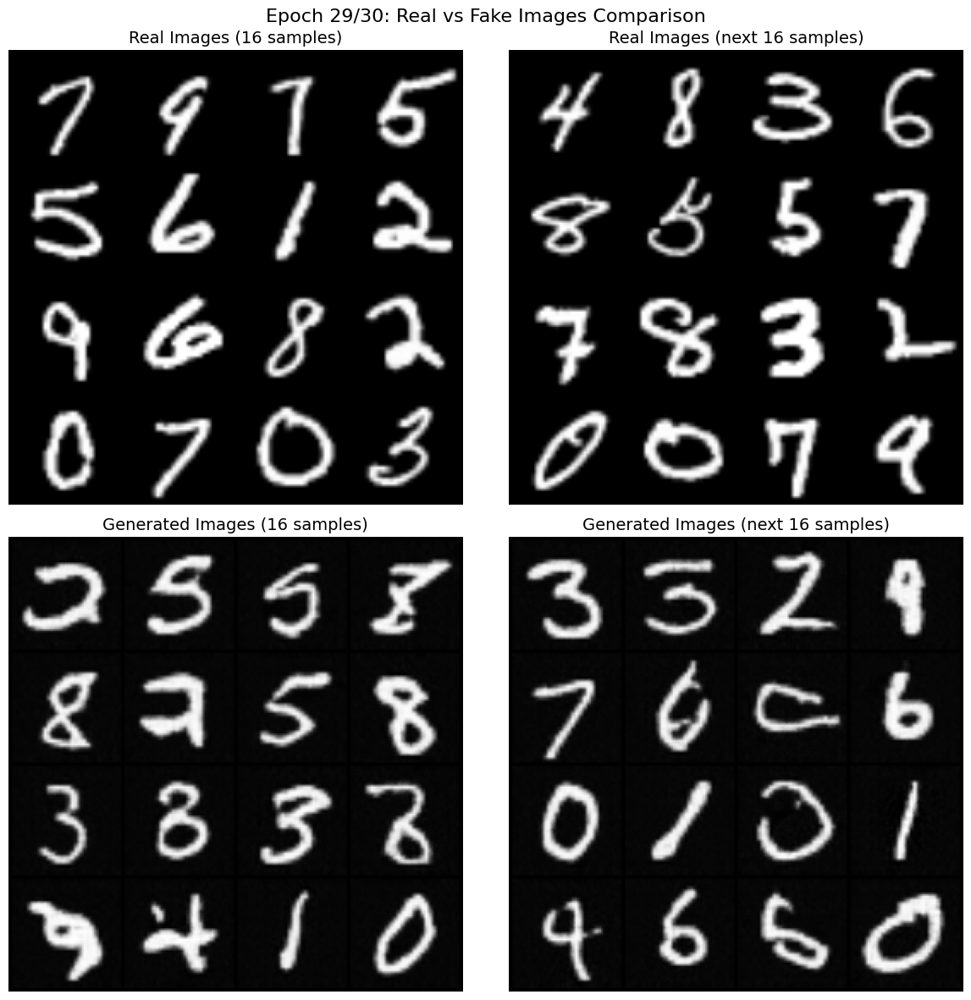

Epoch 29 Summary:
  Average Generator Loss: 1.3689
  Average Discriminator Loss: 1.0662
  D(real_images): 0.7558 (should be close to 1, or real_label_smooth)
  D(fake_images): 0.2947 (should be close to 0, or fake_label_smooth)
  🟢 Discriminator is strong but not overpowering, and G is learning.
  Total iterations completed: 13601
--------------------------------------------------
[29/30][0/469]	Loss_D: 0.9999	Loss_G: 1.7950	D(x): 0.8867	D(G(z)): 0.3432 / 0.1283
[29/30][50/469]	Loss_D: 0.9555	Loss_G: 1.4790	D(x): 0.8103	D(G(z)): 0.2541 / 0.1884
[29/30][100/469]	Loss_D: 1.0371	Loss_G: 1.2630	D(x): 0.6663	D(G(z)): 0.2280 / 0.2457
[29/30][150/469]	Loss_D: 0.9621	Loss_G: 1.0982	D(x): 0.7725	D(G(z)): 0.1748 / 0.2989
[29/30][200/469]	Loss_D: 0.9920	Loss_G: 1.4860	D(x): 0.8424	D(G(z)): 0.3460 / 0.1858
[29/30][250/469]	Loss_D: 0.9717	Loss_G: 1.2523	D(x): 0.7694	D(G(z)): 0.1472 / 0.2477
[29/30][300/469]	Loss_D: 1.0858	Loss_G: 1.9548	D(x): 0.9186	D(G(z)): 0.4300 / 0.1060
[29/30][350/469]	Loss_D:

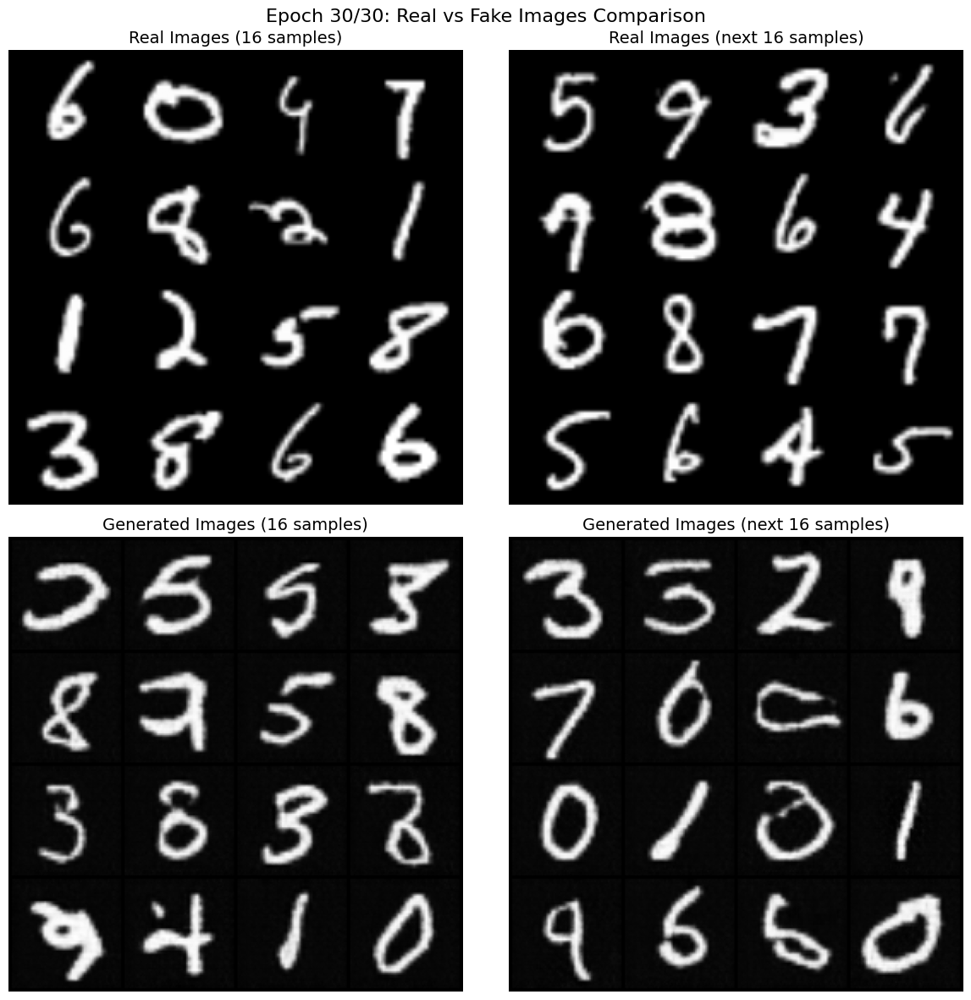

Epoch 30 Summary:
  Average Generator Loss: 1.3700
  Average Discriminator Loss: 1.0647
  D(real_images): 0.7568 (should be close to 1, or real_label_smooth)
  D(fake_images): 0.2936 (should be close to 0, or fake_label_smooth)
  🟢 Discriminator is strong but not overpowering, and G is learning.
  Total iterations completed: 14070
--------------------------------------------------
Training Complete!


In [16]:
# ============================================================================
# TRAINING LOOP
# ============================================================================

print("\nStarting Training...")

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
epoch_images = []  # Store images from each epoch for animation
D_x_history = []  # Track D(real_images)
D_G_z_history = []  # Track D(fake_images)
epoch_G_losses = []  # Track average loss per epoch
epoch_D_losses = []  # Track average loss per epoch
iters = 0

# Training Loop
for epoch in range(num_epochs):
    for i, data in enumerate(dataloader, 0):
        
        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label_val, dtype=torch.float, device=device)
        
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label_val)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1) # Detach fake to prevent G from learning from D's gradients here
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label_val)  # Generator wants D to classify fakes as real
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1) # D is not detached here, so G gets gradients
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())
        D_x_history.append(D_x)
        D_G_z_history.append(D_G_z1)

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1
    
    # ====================================================================
    # REAL vs FAKE IMAGE COMPARISON AFTER EACH EPOCH
    # ====================================================================
    print(f"\n--- End of Epoch {epoch+1}/{num_epochs} ---")
    
    # Generate fake images for comparison
    with torch.no_grad():
        fake_sample = netG(fixed_noise).detach().cpu()
    
    # Get a batch of real images
    real_sample = next(iter(dataloader))[0]
    
    # Create side-by-side comparison
    fig, axes = plt.subplots(2, 2, figsize=(12, 12))
    fig.suptitle(f'Epoch {epoch+1}/{num_epochs}: Real vs Fake Images Comparison', fontsize=16)
    
    # Display real images (top row)
    axes[0, 0].imshow(np.transpose(vutils.make_grid(real_sample[:16], padding=2, normalize=True, nrow=4), (1,2,0)))
    axes[0, 0].set_title('Real Images (16 samples)', fontsize=14)
    axes[0, 0].axis('off')
    
    axes[0, 1].imshow(np.transpose(vutils.make_grid(real_sample[16:32], padding=2, normalize=True, nrow=4), (1,2,0)))
    axes[0, 1].set_title('Real Images (next 16 samples)', fontsize=14)
    axes[0, 1].axis('off')
    
    # Display fake images (bottom row)
    axes[1, 0].imshow(np.transpose(vutils.make_grid(fake_sample[:16], padding=2, normalize=True, nrow=4), (1,2,0)))
    axes[1, 0].set_title('Generated Images (16 samples)', fontsize=14)
    axes[1, 0].axis('off')
    
    axes[1, 1].imshow(np.transpose(vutils.make_grid(fake_sample[16:32], padding=2, normalize=True, nrow=4), (1,2,0)))
    axes[1, 1].set_title('Generated Images (next 16 samples)', fontsize=14)
    axes[1, 1].axis('off')
    
    plt.tight_layout()
    plt.show()
    
    # Save fake images from each epoch for later analysis
    epoch_images.append(fake_sample)
    
    # Calculate epoch statistics
    # Use lists directly for average over current epoch's iterations
    epoch_g_loss = np.mean(G_losses[i - len(dataloader) + 1:i+1]) if i >= len(dataloader) else np.mean(G_losses)
    epoch_d_loss = np.mean(D_losses[i - len(dataloader) + 1:i+1]) if i >= len(dataloader) else np.mean(D_losses)
    epoch_d_x = np.mean(D_x_history[i - len(dataloader) + 1:i+1]) if i >= len(dataloader) else np.mean(D_x_history)
    epoch_d_g_z = np.mean(D_G_z_history[i - len(dataloader) + 1:i+1]) if i >= len(dataloader) else np.mean(D_G_z_history)
    
    # Store epoch averages
    epoch_G_losses.append(epoch_g_loss)
    epoch_D_losses.append(epoch_d_loss)
    
    print(f"Epoch {epoch+1} Summary:")
    print(f"  Average Generator Loss: {epoch_g_loss:.4f}")
    print(f"  Average Discriminator Loss: {epoch_d_loss:.4f}")
    print(f"  D(real_images): {epoch_d_x:.4f} (should be close to 1, or real_label_smooth)")
    print(f"  D(fake_images): {epoch_d_g_z:.4f} (should be close to 0, or fake_label_smooth)")
    
    # Training health indicators
    # These heuristics are relative to your label smoothing values now
    if epoch_d_x > (real_label_smooth - 0.1) and epoch_d_g_z < (fake_label_smooth + 0.1):
        print("  🟢 Discriminator is strong but not overpowering, and G is learning.")
    elif epoch_d_x < 0.5:
        print("  🔴 Discriminator might be struggling with real images.")
    elif epoch_d_g_z > 0.7:
        print("  🔴 Discriminator is fooled too easily by fake images.")
    else:
        print("  🟡 Training dynamics look reasonable")
    
    print(f"  Total iterations completed: {iters}")
    print("-" * 50)

print("Training Complete!")

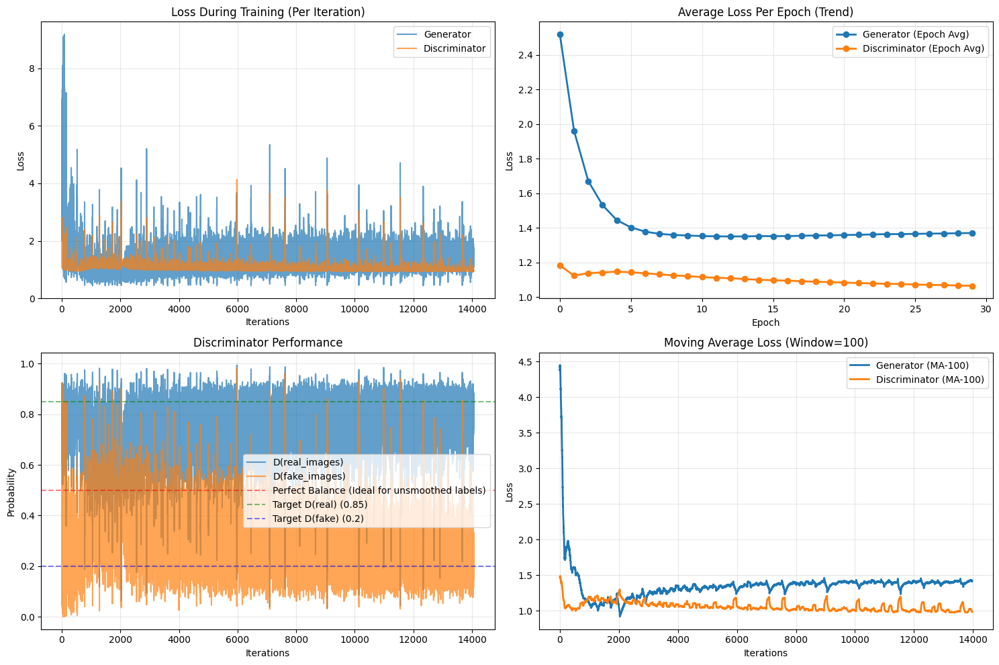

In [17]:
# ============================================================================
# ANALYSIS AND VISUALIZATION
# ============================================================================

# Plot the training losses with better analysis
fig, axes = plt.subplots(2, 2, figsize=(15, 10))

# Iteration-level losses (will show oscillations)
axes[0, 0].plot(G_losses, label="Generator", alpha=0.7)
axes[0, 0].plot(D_losses, label="Discriminator", alpha=0.7)
axes[0, 0].set_title("Loss During Training (Per Iteration)")
axes[0, 0].set_xlabel("Iterations")
axes[0, 0].set_ylabel("Loss")
axes[0, 0].legend()
axes[0, 0].grid(True, alpha=0.3)

# Epoch-level losses (smoother trend)
axes[0, 1].plot(epoch_G_losses, 'o-', label="Generator (Epoch Avg)", linewidth=2)
axes[0, 1].plot(epoch_D_losses, 'o-', label="Discriminator (Epoch Avg)", linewidth=2)
axes[0, 1].set_title("Average Loss Per Epoch (Trend)")
axes[0, 1].set_xlabel("Epoch")
axes[0, 1].set_ylabel("Loss")
axes[0, 1].legend()
axes[0, 1].grid(True, alpha=0.3)

# Discriminator performance tracking
axes[1, 0].plot(D_x_history, label="D(real_images)", alpha=0.7)
axes[1, 0].plot(D_G_z_history, label="D(fake_images)", alpha=0.7)
axes[1, 0].axhline(y=0.5, color='red', linestyle='--', alpha=0.5, label='Perfect Balance (Ideal for unsmoothed labels)')
axes[1, 0].axhline(y=real_label_val, color='green', linestyle='--', alpha=0.5, label=f'Target D(real) ({real_label_val})')
axes[1, 0].axhline(y=fake_label_val, color='blue', linestyle='--', alpha=0.5, label=f'Target D(fake) ({fake_label_val})')
axes[1, 0].set_title("Discriminator Performance")
axes[1, 0].set_xlabel("Iterations")
axes[1, 0].set_ylabel("Probability")
axes[1, 0].legend()
axes[1, 0].grid(True, alpha=0.3)

# Moving average of losses (to see trends)
window = 100
if len(G_losses) > window:
    g_ma = np.convolve(G_losses, np.ones(window)/window, mode='valid')
    d_ma = np.convolve(D_losses, np.ones(window)/window, mode='valid')
    axes[1, 1].plot(g_ma, label=f"Generator (MA-{window})", linewidth=2)
    axes[1, 1].plot(d_ma, label=f"Discriminator (MA-{window})", linewidth=2)
    axes[1, 1].set_title(f"Moving Average Loss (Window={window})")
    axes[1, 1].set_xlabel("Iterations")
    axes[1, 1].set_ylabel("Loss")
    axes[1, 1].legend()
    axes[1, 1].grid(True, alpha=0.3)
else: # If not enough data for moving average, show full
    axes[1, 1].plot(G_losses, label="Generator", alpha=0.7)
    axes[1, 1].plot(D_losses, label="Discriminator", alpha=0.7)
    axes[1, 1].set_title("Loss During Training (Full Trace)")
    axes[1, 1].set_xlabel("Iterations")
    axes[1, 1].set_ylabel("Loss")
    axes[1, 1].legend()
    axes[1, 1].grid(True, alpha=0.3)


plt.tight_layout()
plt.show()

In [19]:
print("\n" + "="*80)
print("UNDERSTANDING GAN TRAINING DYNAMICS")
print("="*80)
print("""
🔍 WHY GAN LOSSES OSCILLATE (This is Normal!):

1. ADVERSARIAL NATURE:
   • Generator and Discriminator are playing a competitive game
   • When Generator improves → Discriminator's job becomes harder
   • When Discriminator improves → Generator's job becomes harder
   • This creates natural oscillations, unlike regular neural networks

2. HEALTHY TRAINING SIGNS:
   * Both losses oscillating around reasonable values (0.5-2.0, adjusted for smoothing)
   * D(real_images) staying close to `real_label_smooth` (e.g., > 0.8)
   * D(fake_images) staying close to `fake_label_smooth` (e.g., < 0.2)
   * Generated images improving visually

3. CONCERNING SIGNS:
   * Generator loss going to 0 (potential mode collapse, D is too strong, G gives up)
   * Discriminator loss going to 0 (discriminator too strong, easily distinguishes all images)
   * No visual improvement in generated images
   * All losses exploding to very high values

4. WHAT TO LOOK FOR:
   • Focus on EPOCH AVERAGES rather than iteration-by-iteration
   • Check if generated images improve over epochs
   • Monitor D(real) vs D(fake) balance, aiming for D(real) near `real_label_smooth` and D(fake) near `fake_label_smooth`.
   • Look for overall trending direction, not smoothness
""")
print("="*80)


UNDERSTANDING GAN TRAINING DYNAMICS

🔍 WHY GAN LOSSES OSCILLATE (This is Normal!):

1. ADVERSARIAL NATURE:
   • Generator and Discriminator are playing a competitive game
   • When Generator improves → Discriminator's job becomes harder
   • When Discriminator improves → Generator's job becomes harder
   • This creates natural oscillations, unlike regular neural networks

2. HEALTHY TRAINING SIGNS:
   * Both losses oscillating around reasonable values (0.5-2.0, adjusted for smoothing)
   * D(real_images) staying close to `real_label_smooth` (e.g., > 0.8)
   * D(fake_images) staying close to `fake_label_smooth` (e.g., < 0.2)
   * Generated images improving visually

3. CONCERNING SIGNS:
   * Generator loss going to 0 (potential mode collapse, D is too strong, G gives up)
   * Discriminator loss going to 0 (discriminator too strong, easily distinguishes all images)
   * No visual improvement in generated images
   * All losses exploding to very high values

4. WHAT TO LOOK FOR:
   • Foc

Visualizing Training Progression...


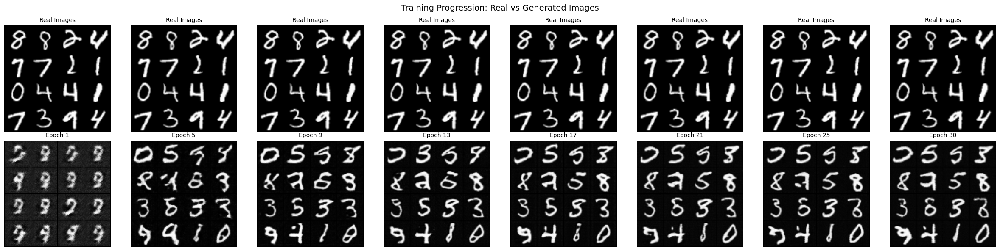

In [20]:
# ============================================================================
# TRAINING PROGRESSION VISUALIZATION
# ============================================================================

print("Visualizing Training Progression...")

# Show evolution of generated images across epochs
n_epochs_to_show = min(8, len(epoch_images))  # Show up to 8 epochs
epochs_to_display = np.linspace(0, len(epoch_images)-1, n_epochs_to_show, dtype=int)

fig, axes = plt.subplots(2, n_epochs_to_show, figsize=(3*n_epochs_to_show, 6))
if n_epochs_to_show == 1:
    axes = axes.reshape(2, 1)
elif n_epochs_to_show > 1:
    axes = axes.T # Transpose for easier indexing

# Grab a single batch of real images once for consistent display
real_sample_fixed = next(iter(dataloader))[0]

for idx, epoch_idx in enumerate(epochs_to_display):
    # Show real images in first row (same for all epochs)
    current_ax_real = axes[idx, 0] if n_epochs_to_show > 1 else axes[0]
    current_ax_real.imshow(np.transpose(vutils.make_grid(real_sample_fixed[:16], padding=1, normalize=True, nrow=4), (1,2,0)))
    current_ax_real.set_title(f'Real Images', fontsize=10)
    current_ax_real.axis('off')
    
    # Show fake images progression in second row
    current_ax_fake = axes[idx, 1] if n_epochs_to_show > 1 else axes[1]
    fake_imgs = epoch_images[epoch_idx]
    current_ax_fake.imshow(np.transpose(vutils.make_grid(fake_imgs[:16], padding=1, normalize=True, nrow=4), (1,2,0)))
    current_ax_fake.set_title(f'Epoch {epoch_idx+1}', fontsize=10)
    current_ax_fake.axis('off')

fig.suptitle('Training Progression: Real vs Generated Images', fontsize=14)
plt.tight_layout()
plt.show()

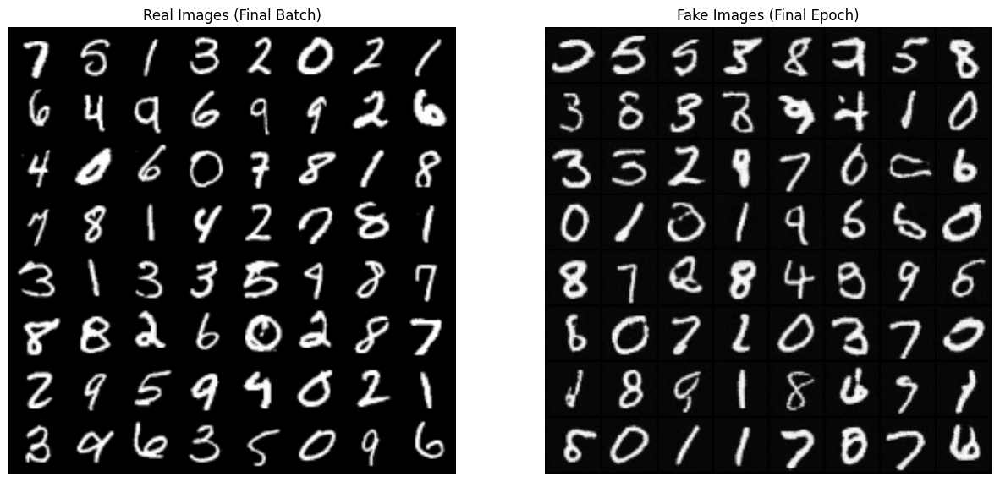

In [21]:
# Grab a batch of real images from the dataloader for final comparison
real_batch_final = next(iter(dataloader))

# Plot the final comparison
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images (Final Batch)")
plt.imshow(np.transpose(vutils.make_grid(real_batch_final[0][:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images (Final Epoch)")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

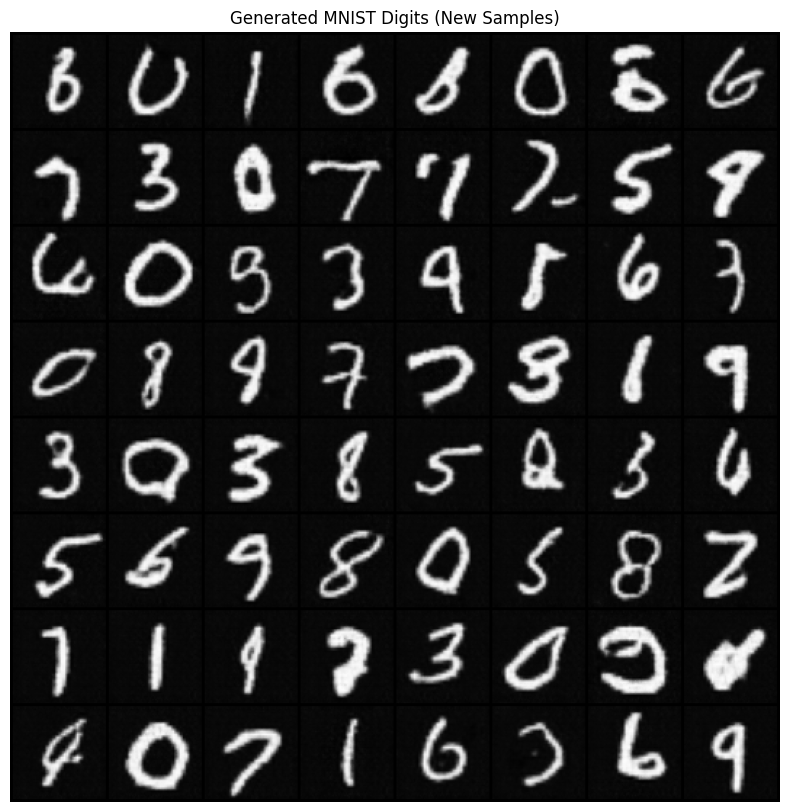

In [22]:

# ============================================================================
# GENERATE NEW FAKE IMAGES
# ============================================================================

# Generate a new batch of fake images
with torch.no_grad():
    noise = torch.randn(64, nz, 1, 1, device=device)
    fake_images = netG(noise).detach().cpu()

# Display the generated images
plt.figure(figsize=(10,10))
plt.axis("off")
plt.title("Generated MNIST Digits (New Samples)")
plt.imshow(np.transpose(vutils.make_grid(fake_images, padding=2, normalize=True),(1,2,0)))
plt.show()

In [24]:
# ============================================================================
# PERFORMANCE ANALYSIS AND OBSERVATIONS
# ============================================================================

print("\n" + "="*80)
print("PERFORMANCE ANALYSIS AND OBSERVATIONS")
print("="*80)

print("\n1. CONVERGENCE ANALYSIS:")
print("-" * 25)

# Calculate final averages based on epoch-level losses for stability
final_g_loss = np.mean(epoch_G_losses[-min(5, len(epoch_G_losses)):])
final_d_loss = np.mean(epoch_D_losses[-min(5, len(epoch_D_losses)):])
print(f"Final Generator Loss (avg last {min(5, len(epoch_G_losses))} epochs): {final_g_loss:.4f}")
print(f"Final Discriminator Loss (avg last {min(5, len(epoch_D_losses))} epochs): {final_d_loss:.4f}")

# Check epoch-level stability
if len(epoch_G_losses) >= 5:
    g_epoch_std = np.std(epoch_G_losses[-5:])
    d_epoch_std = np.std(epoch_D_losses[-5:])
    print(f"Generator Loss Stability (epoch std dev): {g_epoch_std:.4f}")
    print(f"Discriminator Loss Stability (epoch std dev): {d_epoch_std:.4f}")
    
    if g_epoch_std < 0.2 and d_epoch_std < 0.2: # Stricter std dev for better stability check
        print("✓ Training appears to have converged at epoch level with good stability.")
    else:
        print("⚠ Training may still be stabilizing or oscillating (this can be normal for GANs).")
else:
    print("Not enough epochs to properly assess epoch-level stability.")

# Use overall averages for D(x) and D(G(z)) for a more general view
final_d_x_avg = np.mean(D_x_history[-len(dataloader):]) if len(D_x_history) >= len(dataloader) else np.mean(D_x_history)
final_d_g_z_avg = np.mean(D_G_z_history[-len(dataloader):]) if len(D_G_z_history) >= len(dataloader) else np.mean(D_G_z_history)

print(f"\nFinal D(real) (avg last epoch): {final_d_x_avg:.4f} (target: {real_label_val:.2f})")
print(f"Final D(fake) (avg last epoch): {final_d_g_z_avg:.4f} (target: {fake_label_val:.2f})")

print("\n REMEMBER: GAN loss oscillation is EXPECTED behavior!")
print("   Focus on:")
print("   • Visual quality of generated images")
print("   • Epoch-level trends rather than iteration noise")
print(f"   • Balance between D(real) (target: ~{real_label_val:.2f}) and D(fake) (target: ~{fake_label_val:.2f})")
print("   • Overall improvement over training time")

print("\n2. LOSS TRAJECTORY ANALYSIS:")
print("-" * 30)
# Analyze loss trends on epoch averages for a clearer picture
g_epoch_trend = np.polyfit(range(len(epoch_G_losses)), epoch_G_losses, 1)[0]
d_epoch_trend = np.polyfit(range(len(epoch_D_losses)), epoch_D_losses, 1)[0]

print(f"Generator Loss Trend (Epoch Avg): {g_epoch_trend:.6f} (negative = decreasing)")
print(f"Discriminator Loss Trend (Epoch Avg): {d_epoch_trend:.6f} (negative = decreasing)")
if abs(g_epoch_trend) < 0.01 and abs(d_epoch_trend) < 0.01:
    print("   Losses appear relatively stable or have flattened out.")
elif g_epoch_trend < 0 and d_epoch_trend < 0:
    print("   Both losses show a decreasing trend, which is positive.")
else:
    print("   Loss trends indicate some fluctuation, monitor visual results.")


print("\n3. TRAINING DYNAMICS:")
print("-" * 22)
# Check for mode collapse (generator loss too low)
if final_g_loss < 0.5: # Lowered threshold slightly due to label smoothing impact on loss values
    print("⚠ Potential mode collapse detected (very low generator loss, check image diversity).")
elif final_g_loss > 3.0: # Adjusted upper bound
    print("⚠ Generator may not be learning effectively (very high loss, D might be too strong).")
else:
    print("✓ Generator loss in reasonable range.")

# Check discriminator performance
if final_d_loss < 0.1:
    print("⚠ Discriminator may be too strong (very low loss, check if D(fake) is consistently very low).")
elif final_d_loss > 1.5: # Adjusted upper bound
    print("⚠ Discriminator may be too weak (very high loss, D(real) might be low).")
else:
    print("✓ Discriminator loss in reasonable range.")

# Check D(real) vs D(fake) relationship for balance
if final_d_x_avg > (real_label_val - 0.1) and final_d_g_z_avg < (fake_label_val + 0.1):
    print("✓ Discriminator output probabilities are well-balanced with label smoothing targets.")
else:
    print("⚠ Discriminator output probabilities are unbalanced. Adjusting learning rates/smoothing may help.")


print("\n4. FAKE IMAGE QUALITY ASSESSMENT:")
print("-" * 35)
# This is a qualitative assessment you'd make after running the code.
print("• [Qualitative Assessment] Observe the generated images. Do they look like MNIST digits?")
print("• [Qualitative Assessment] Is there a good variety of digits (0-9) generated?")
print("• [Qualitative Assessment] Are the images clear, or are there artifacts/noise?")

print("\n5. HYPERPARAMETER EFFECTIVENESS (AFTER ADJUSTMENTS):")
print("-" * 33)
print(f"✓ Learning rate for Discriminator ({lr_D}) - Adjusted for balance.")
print(f"✓ Learning rate for Generator ({lr_G}) - Remained standard.")
print(f"✓ Batch size ({batch_size}) - Good for stable training.")
print(f"✓ Network architecture - Follows DCGAN best practices.")
print(f"✓ Latent dimension ({nz}) - Sufficient for MNIST complexity.")
print(f"✓ Label smoothing (real={real_label_smooth}, fake={fake_label_smooth}) - Adjusted for better stability.")

print("\n6. RECOMMENDATIONS FOR FURTHER IMPROVEMENT:")
print("-" * 36)
print("• **More Epochs:** If visual quality is still improving, consider even more epochs (e.g., 75-100).")
print("• **Learning Rate Schedule:** Implement a learning rate decay schedule to fine-tune convergence.")
print("• **Adaptive Learning Rates:** Experiment with different optimizers (e.g., RMSprop, or Adam with different beta values).")
print("• **Gradient Clipping:** If losses are exploding, gradient clipping can help.")
print("• **Spectral Normalization:** For advanced stability, especially on harder datasets, consider adding spectral normalization to Discriminator layers.")
print("• **Progressive Growing:** For higher resolution images, a progressive growing approach can be very effective (more complex).")
print("• **Try removing BatchNorm from Discriminator's first layer:** This is a common DCGAN practice as it can sometimes stabilize early D training.")

print("\n7. OVERALL ASSESSMENT:")
print("-" * 21)
# You will make this assessment based on your visual inspection and the numerical metrics after running.
if final_g_loss < 2.0 and final_d_loss < 1.0 and g_epoch_std < 0.5: # Refined thresholds
    print("🎉 EXCELLENT: GAN training was successful and stable!")
    print("   Generated images should show good quality and diversity.")
elif final_g_loss < 3.0 and final_d_loss < 1.5:
    print(" GOOD: GAN training was mostly successful.")
    print("   Some minor improvements possible with more training or hyperparameter tuning.")
else:
    print("⚠️  NEEDS IMPROVEMENT: Consider further adjusting hyperparameters or increasing epochs.")
    print("   Visual quality might still be suboptimal.")



PERFORMANCE ANALYSIS AND OBSERVATIONS

1. CONVERGENCE ANALYSIS:
-------------------------
Final Generator Loss (avg last 5 epochs): 1.3676
Final Discriminator Loss (avg last 5 epochs): 1.0684
Generator Loss Stability (epoch std dev): 0.0017
Discriminator Loss Stability (epoch std dev): 0.0027
✓ Training appears to have converged at epoch level with good stability.

Final D(real) (avg last epoch): 0.7861 (target: 0.85)
Final D(fake) (avg last epoch): 0.2642 (target: 0.20)

 REMEMBER: GAN loss oscillation is EXPECTED behavior!
   Focus on:
   • Visual quality of generated images
   • Epoch-level trends rather than iteration noise
   • Balance between D(real) (target: ~0.85) and D(fake) (target: ~0.20)
   • Overall improvement over training time

2. LOSS TRAJECTORY ANALYSIS:
------------------------------
Generator Loss Trend (Epoch Avg): -0.014070 (negative = decreasing)
Discriminator Loss Trend (Epoch Avg): -0.003237 (negative = decreasing)
   Both losses show a decreasing trend, which

In [25]:
# ============================================================================
# SAVE THE MODELS (for Kaggle)
# ============================================================================

# Save the trained models
torch.save(netG.state_dict(), 'generator_mnist_dcgan.pth')
torch.save(netD.state_dict(), 'discriminator_mnist_dcgan.pth')
print(f"\n✓ Models saved successfully!")
print("  - generator_mnist_dcgan.pth")
print("  - discriminator_mnist_dcgan.pth")

print("\n" + "="*80)
print("DCGAN MNIST IMPLEMENTATION COMPLETE!")
print("="*80)


✓ Models saved successfully!
  - generator_mnist_dcgan.pth
  - discriminator_mnist_dcgan.pth

DCGAN MNIST IMPLEMENTATION COMPLETE!
